# Labolatorium nr 4 - Symulowane wyżarzanie

#### Patryk Klatka
#### 5 kwietnia 2023

## Wstęp

Symulowane wyżarzanie to metaheurystyka pozwalająca na aproksymację globalnego optimum zadanej funkcji. Jest to algorytm, który w każdym kroku iteracji wybiera losowo następny stan. Następnie obliczany jest koszt (lub energia) danego stanu. Jeśli stan ten ma mniejszy koszt niż poprzedni, to jest on akceptowany. W przeciwnym wypadku jest on akceptowany z pewnym prawdopodobieństwem, które zależy od temperatury. Temperatura jest zmniejszana w każdej iteracji. Algorytm kończy działanie, gdy temperatura spadnie do zera lub wykonane zostaną wszystkie iteracje. Czasami algorytm może "utknąć" w minimum lokalnym, wtedy należy powtórzyć procedurę symulowanego wyżarzania.

Sprawozdanie zostało napisane w Jupyter Notebooku, w celu przedstawienia nie tylko wniosków z przeprowadzonego labolatorium, ale również kodu, który został wykorzystany do jego wykonania.

## Import bibliotek oraz ich konfiguracja

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import time

# Matplotlib settings
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
plt.style.use('ggplot')

## Zadanie 1 - Travelling Salesman Problem

W celu obliczenia przybliżonego rozwiązania problemu komiwojażera, została metoda technika symulowanego wyżarzania. Funkcja, którą będziemy minimalizować, to suma odległości między odpowiednimi punktami. Sąsiednie stany będziemy generować na dwa sposoby: zamieniając dowolne dwa punkty (arbitrary swap) albo dwa kolejne punkty (consecutive swap).

### Generowanie chmur losowych punktów i wizualizacja otrzymanego rozwiązania

Wygenerowano różne zestawy punktów (rozkład jednostajny, normalny, dziewięć odseparowanych grup punktów) w celu zbadania poprawności działania algorytmu. Dla każdego zestawu wykonano $10^4$ iteracji oraz wykorzystano funkcję eksponencjalną jako funkcję zmiany temperatury. Następne stany są generowane metodą arbitrary swap.

In [2]:
n1 = 10
n2 = 40
n3 = 100
n4 = 200
normal_parameters_1 = (0, 1)
normal_parameters_2 = (5, 2)
normal_parameters_3 = (2, 1)
normal_parameters_4 = (8, 10)

# Uniform distribution

uniform_dataset_1 = np.random.uniform(0, 10, size=(n1, 2))
uniform_dataset_2 = np.random.uniform(0, 10, size=(n2, 2))
uniform_dataset_3 = np.random.uniform(0, 10, size=(n3, 2))

# Normal distribution

normal_dataset_1_p1 = np.random.normal(*normal_parameters_1, size=(n2, 2))
normal_dataset_2_p1 = np.random.normal(*normal_parameters_1, size=(n2, 2))
normal_dataset_3_p1 = np.random.normal(*normal_parameters_1, size=(n2, 2))
normal_dataset_4_p1 = np.random.normal(*normal_parameters_1, size=(n2, 2))

normal_dataset_1_p2 = np.random.normal(*normal_parameters_2, size=(n2, 2))
normal_dataset_2_p2 = np.random.normal(*normal_parameters_2, size=(n2, 2))
normal_dataset_3_p2 = np.random.normal(*normal_parameters_2, size=(n2, 2))
normal_dataset_4_p2 = np.random.normal(*normal_parameters_1, size=(n2, 2))

normal_dataset_1_p3 = np.random.normal(*normal_parameters_3, size=(n2, 2))
normal_dataset_2_p3 = np.random.normal(*normal_parameters_3, size=(n2, 2))
normal_dataset_3_p3 = np.random.normal(*normal_parameters_3, size=(n2, 2))
normal_dataset_4_p3 = np.random.normal(*normal_parameters_1, size=(n2, 2))

normal_dataset_1_p4 = np.random.normal(*normal_parameters_4, size=(n2, 2))
normal_dataset_2_p4 = np.random.normal(*normal_parameters_4, size=(n2, 2))
normal_dataset_3_p4 = np.random.normal(*normal_parameters_4, size=(n2, 2))
normal_dataset_4_p4 = np.random.normal(*normal_parameters_1, size=(n2, 2))


# 9 groups of points

def generate_9_point_groups(n):
    centers=[(3.0, 3.0), (10.0, 3.0), (17.0, 3.0), (3.0, 10.0), 
             (10.0, 10.0), (17.0, 10.0), (3.0, 17.0), (10.0, 17.0), (17.0, 17.0)]
    x1 = np.random.normal(loc=centers[0][0], size=n).reshape(-1,1)
    y1 = np.random.normal(loc=centers[0][1], size=n).reshape(-1,1)
    group_points = np.concatenate((x1,y1),axis=1)
    for x,y in centers[1:]:
        x1 = np.random.normal(loc=x, size=n).reshape(-1,1)
        y1 = np.random.normal(loc=y, size=n).reshape(-1,1)
        t1 = np.concatenate((x1,y1),axis=1)
        group_points = np.concatenate((t1,group_points),axis=0)
    
    np.random.shuffle(group_points)
    return group_points

group_points_1 = generate_9_point_groups(4)
group_points_2 = generate_9_point_groups(8)
group_points_3 = generate_9_point_groups(20)

#### Klasa reprezentująca temperaturę

In [2]:
class Temperature():
    EXPONENTIAL=1
    LINEAR=2

    def __init__(self, start_temp, update_function, delta = None):
        self.max_temp = start_temp
        self.temp = start_temp
        if update_function == Temperature.EXPONENTIAL:
            self.update_function = self.exponential_function
        elif update_function == Temperature.LINEAR:
            self.update_function = self.linear_function
        else:
            raise ValueError("Invalid update function")
        
        if delta is None:
            if update_function == Temperature.EXPONENTIAL:
                self.delta = 10/self.max_temp
            elif update_function == Temperature.LINEAR:
                self.delta = 1
        else:
            self.delta = delta

        self.probability = 1

    def exponential_function(self):
        self.probability = np.exp(self.temp - self.max_temp)
    
    def linear_function(self):
        self.probability = self.temp / self.max_temp
    
    def cool_down(self):
        self.temp -= self.delta
        return self.update_function()

#### Funkcje pomocnicze

In [4]:
def path_cost(path):
    cost = 0
    for i in range(len(path) - 1):
        cost += np.linalg.norm(path[i] - path[i + 1])
    return cost


def plot_result(initial_route, final_route, cost_history, prob_history, show_data_charts=True):
    # Plot initial route
    fig, ax = plt.subplots(1, 2, figsize=(20, 10))
    
    new_initial_route = initial_route.copy()
    new_initial_route = np.concatenate((new_initial_route, [new_initial_route[0]]), axis=0)

    ax[0].plot(new_initial_route[:, 0], new_initial_route[:, 1])
    ax[0].scatter(x=initial_route[:, 0], y=initial_route[:, 1], c='r')
    ax[0].set_title('Initial route')
    ax[0].set_xlabel('X')
    ax[0].set_ylabel('Y')

    new_final_route = final_route.copy()
    new_final_route = np.concatenate((new_final_route, [new_final_route[0]]), axis=0)

    ax[1].plot(new_final_route[:, 0], new_final_route[:, 1])
    ax[1].scatter(x=final_route[:, 0], y=final_route[:, 1], c='r')
    ax[1].set_title('Final route')
    ax[1].set_xlabel('X')
    ax[1].set_ylabel('Y')

    plt.show()

    if show_data_charts:
        fig, ax = plt.subplots(1, 2, figsize=(20, 10))

        ax[0].plot(cost_history)
        ax[0].set_title('Distance over iterations')
        ax[0].set_xlabel('Iteration')
        ax[0].set_ylabel('Distance')

        ax[1].plot(prob_history)
        ax[1].set_title('Probability of taking worse solution over iterations')
        ax[1].set_xlabel('Iteration')
        ax[1].set_ylabel('Probability')

        plt.show()

#### Funkcja minimalizująca koszt podróży

In [5]:
def tsp_solver(dataset, consecutive_swap=True, temperature_function=Temperature.EXPONENTIAL, iterations = 100000, delta=None):
    # Generate initial route
    route = dataset.copy()
    best_route = route.copy()
    
    # Get cost of initial route
    current_fitness = path_cost(route)
    best_fitness = current_fitness

    # Run simmulated annealing to optimize cost of path
    T = Temperature(iterations, temperature_function, delta)
    prob_history = []
    fitness_history = []
    for i in range(iterations):
        # Get random points
        p1, p2 = np.random.choice(range(len(route)), size=2, replace=False)

        if consecutive_swap:
            p2 = (p1 + 1) % len(route)

        # Candidate route
        candidate = route.copy()
        candidate[[p1, p2]] = candidate[[p2, p1]]

        fit_difference = path_cost(candidate) - current_fitness

        prob_history.append(T.probability)

        if fit_difference < 0:
            route = candidate.copy()
            current_fitness = path_cost(route)
            if current_fitness < best_fitness:
                best_route = route.copy()
                best_fitness = current_fitness
        elif np.random.uniform(0, 1) < T.probability:
            route = candidate.copy()
            current_fitness = path_cost(route)

        T.cool_down()
        fitness_history.append(current_fitness)

    return best_route, fitness_history, prob_history

#### Rozkład normalny z parametrami $\mu = 0$ i $\sigma = 1$

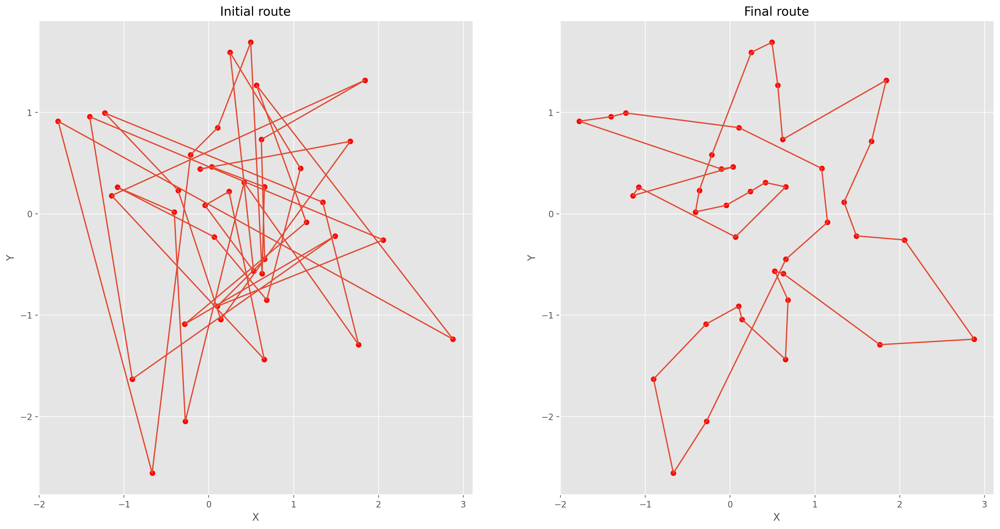

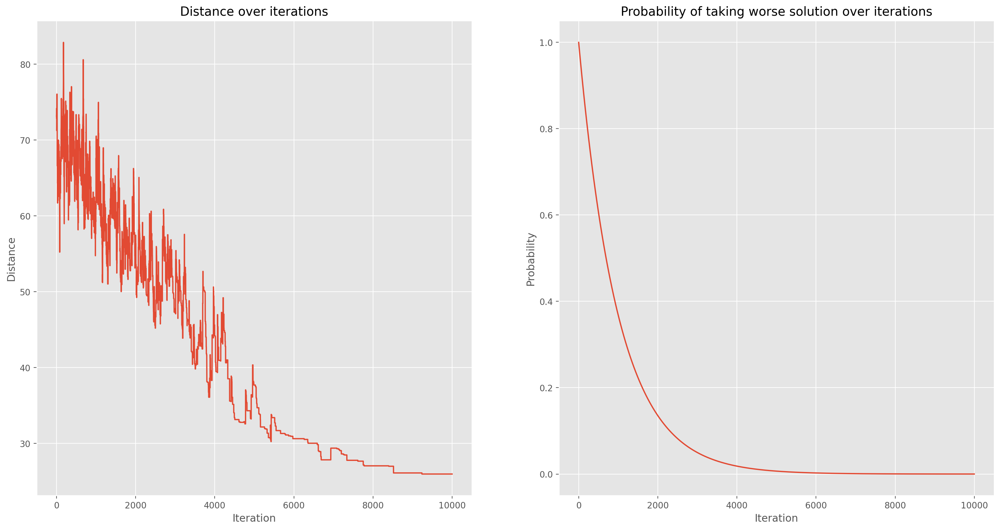

In [6]:
plot_result(normal_dataset_1_p1, 
            *tsp_solver(normal_dataset_1_p1, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000),
            show_data_charts=True)

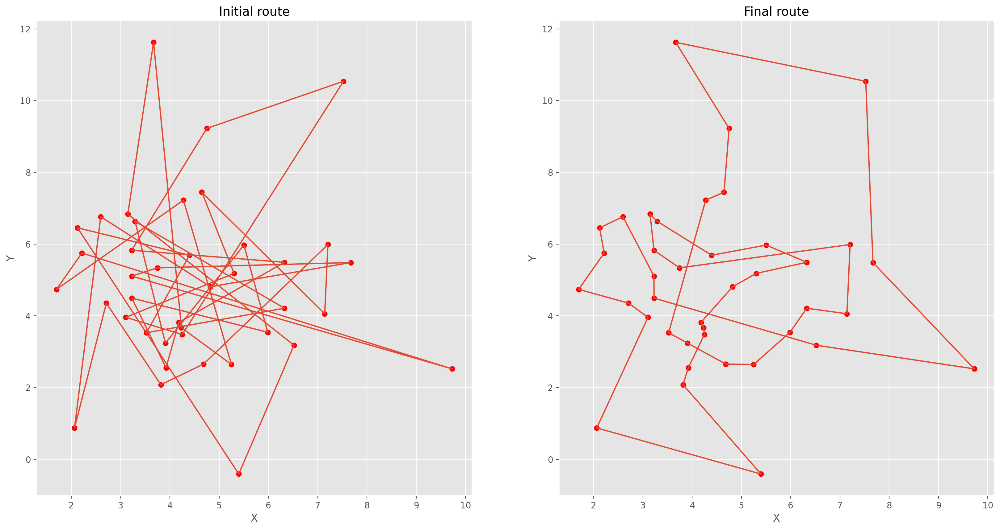

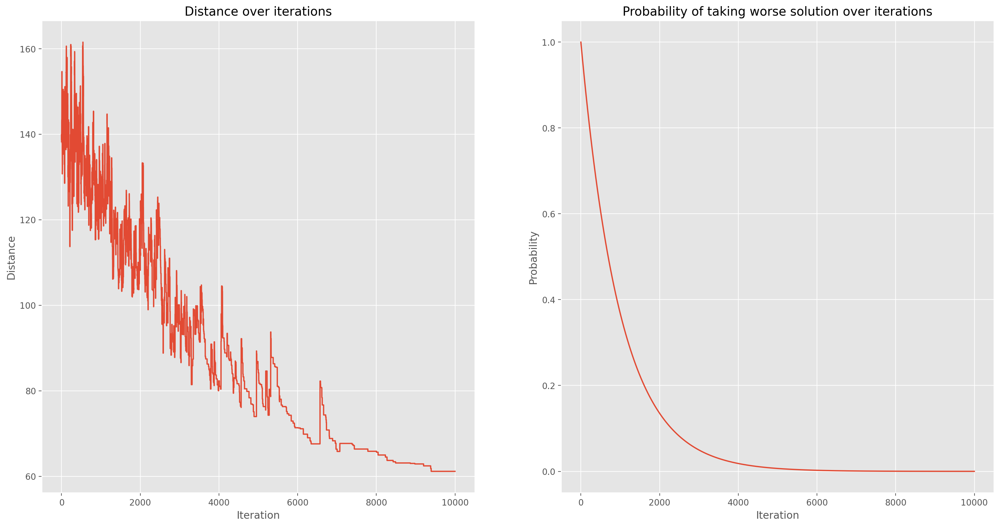

In [7]:
plot_result(normal_dataset_1_p2, 
            *tsp_solver(normal_dataset_1_p2, 
                        consecutive_swap=False,
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000), 
            show_data_charts=True)

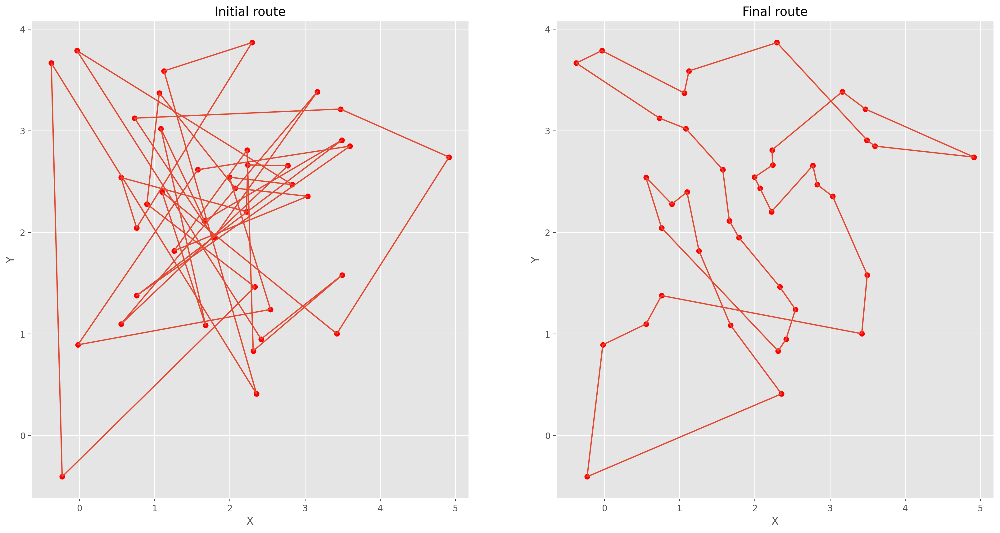

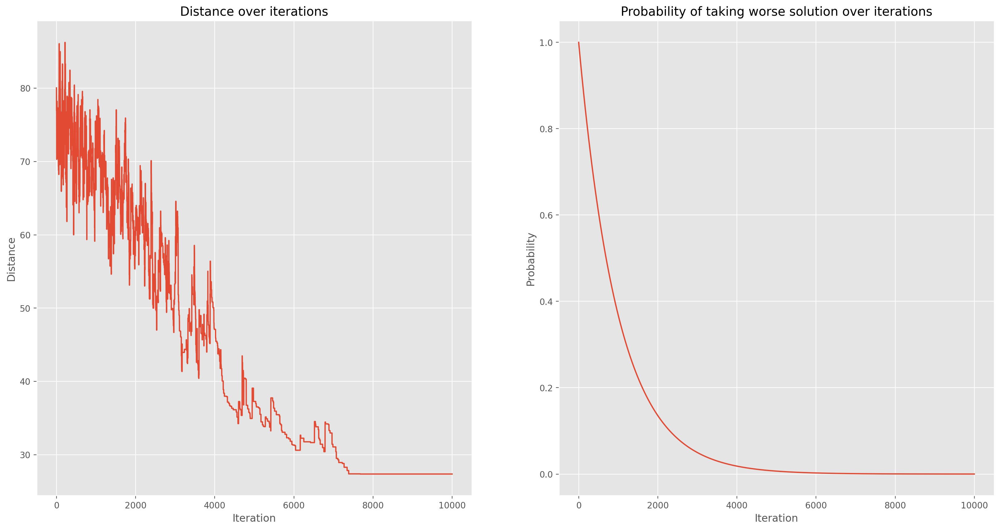

In [8]:
plot_result(normal_dataset_1_p3, 
            *tsp_solver(normal_dataset_1_p3, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000), 
            show_data_charts=True)

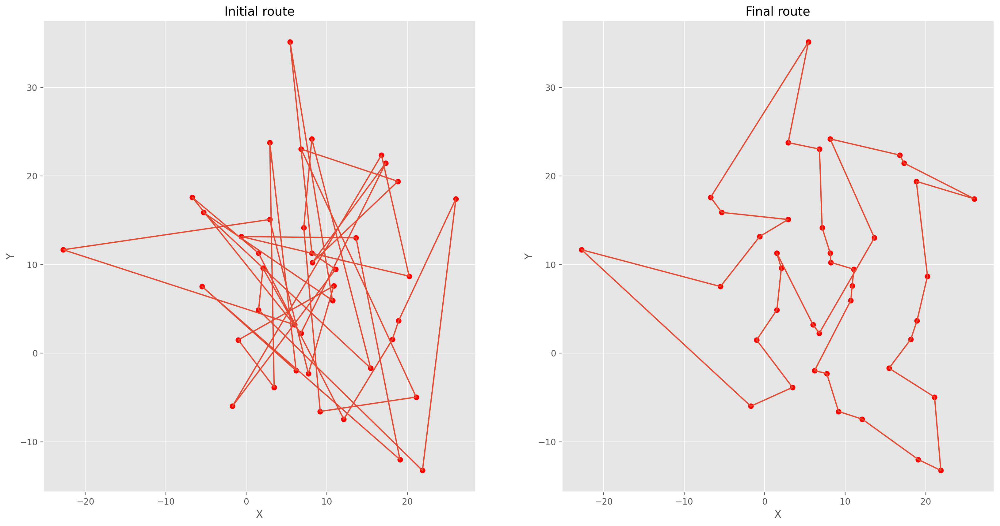

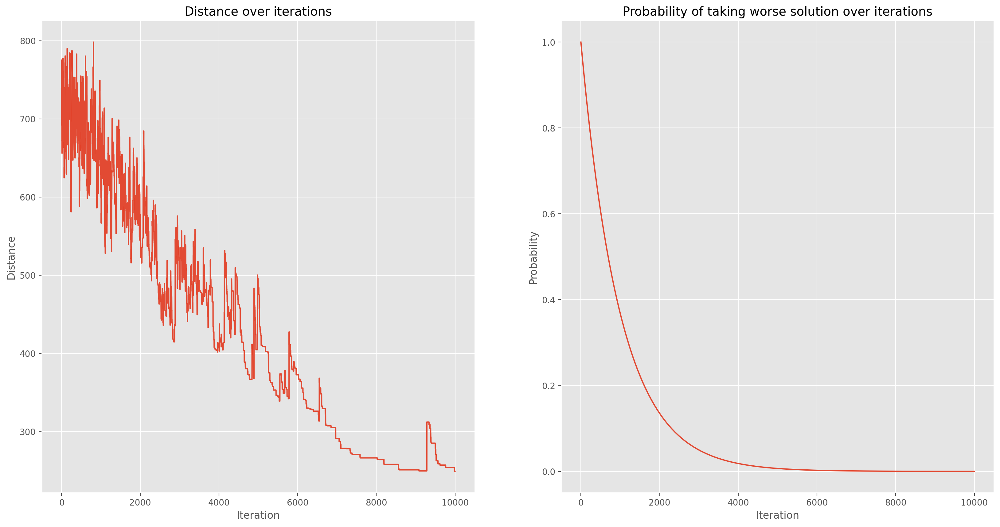

In [9]:
plot_result(normal_dataset_1_p4, 
            *tsp_solver(normal_dataset_1_p4,
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000), 
            show_data_charts=True)

#### Rozkład normalny z parametrami $\mu = 5$ i $\sigma = 2$

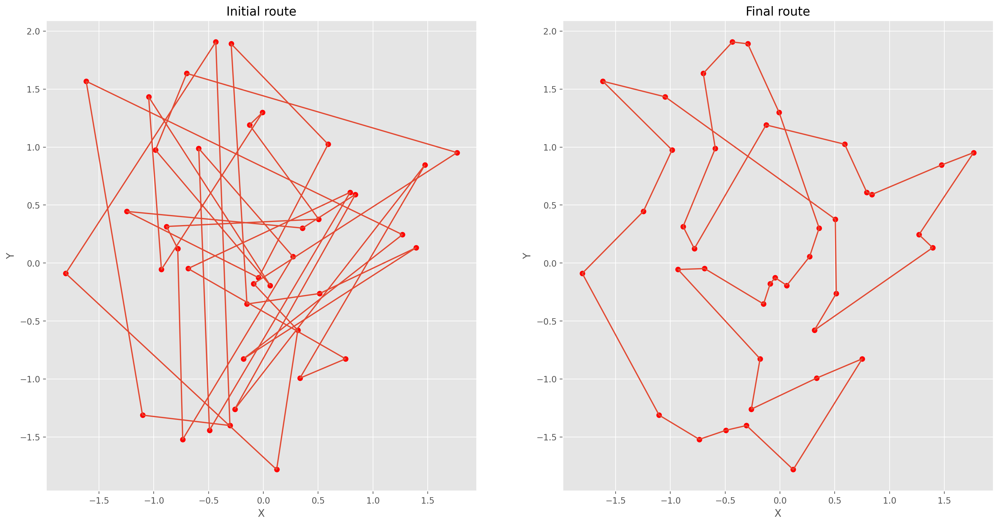

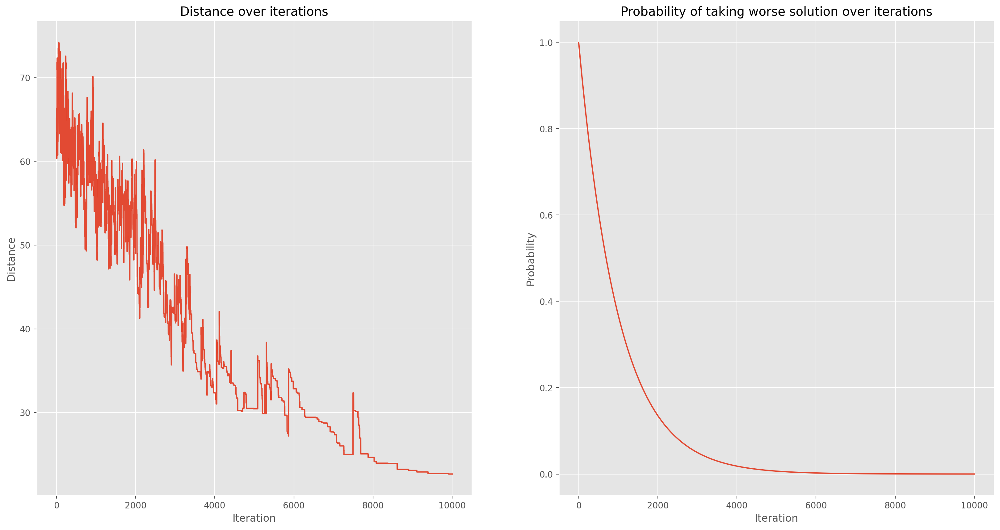

In [10]:
plot_result(normal_dataset_2_p1, 
            *tsp_solver(normal_dataset_2_p1, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000), 
            show_data_charts=True)

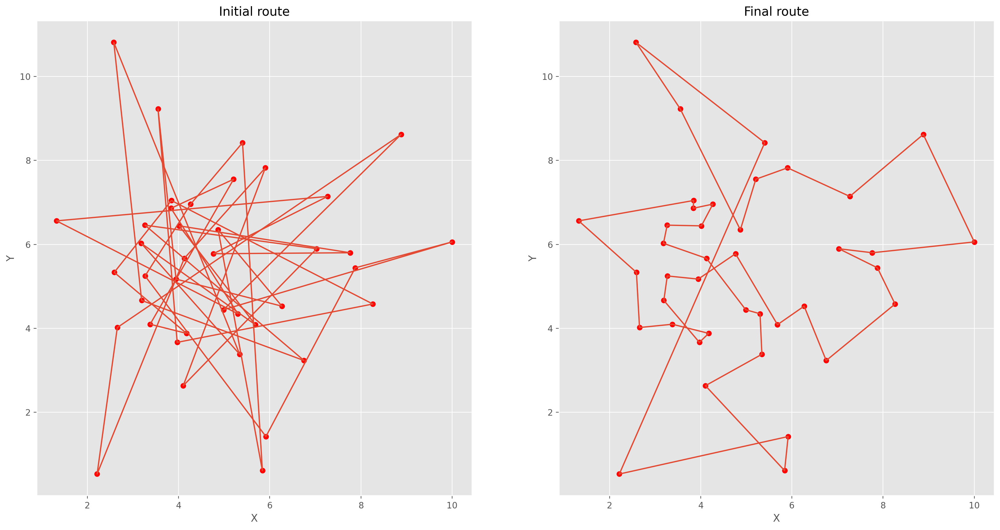

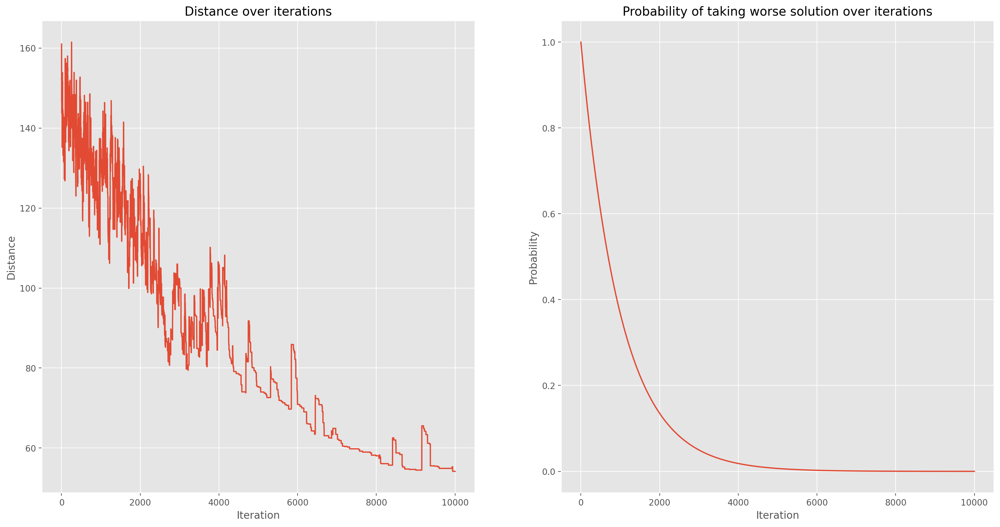

In [11]:
plot_result(normal_dataset_2_p2, 
            *tsp_solver(normal_dataset_2_p2, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000), 
            show_data_charts=True)

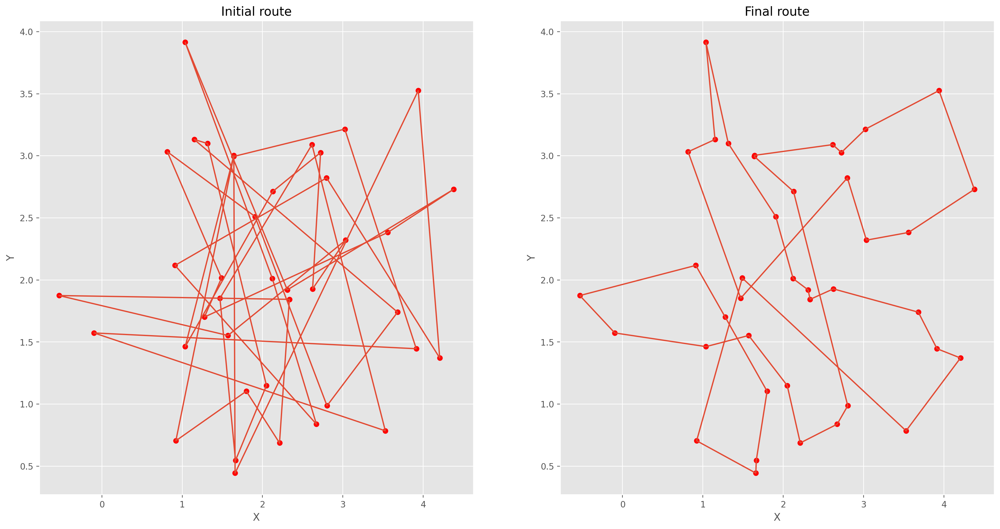

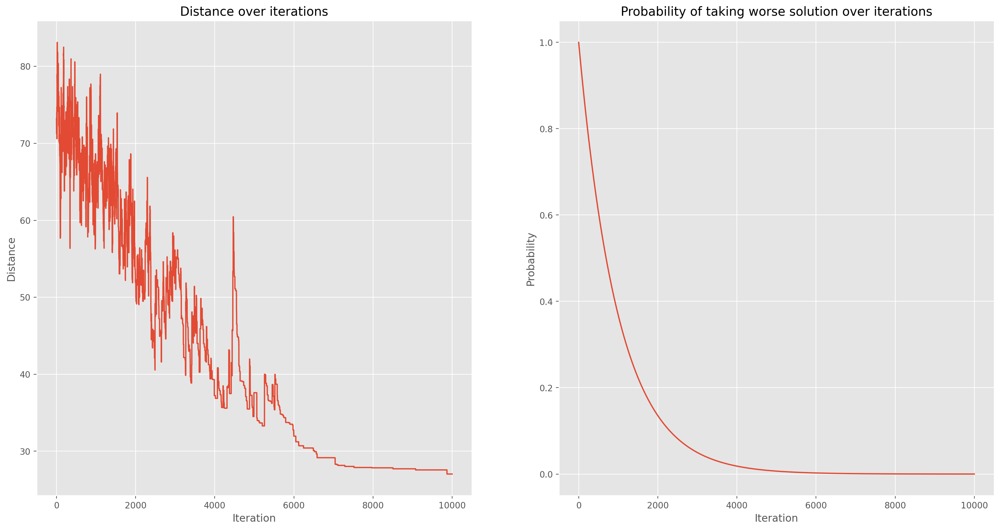

In [12]:
plot_result(normal_dataset_2_p3, 
            *tsp_solver(normal_dataset_2_p3, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL,
                        iterations=10000), 
            show_data_charts=True)

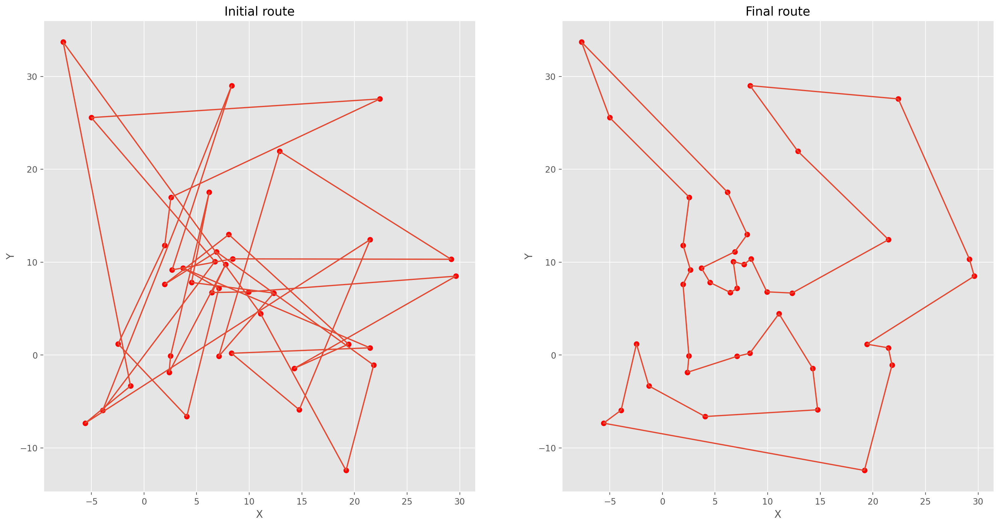

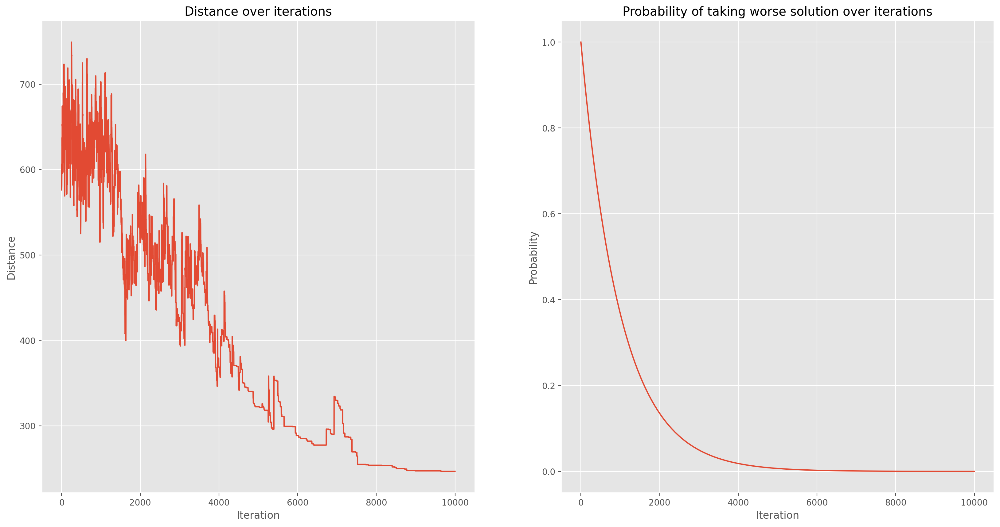

In [13]:
plot_result(normal_dataset_2_p4, 
            *tsp_solver(normal_dataset_2_p4, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000), 
            show_data_charts=True)

#### Rozkład normalny z parametrami $\mu = 2$ i $\sigma = 1$

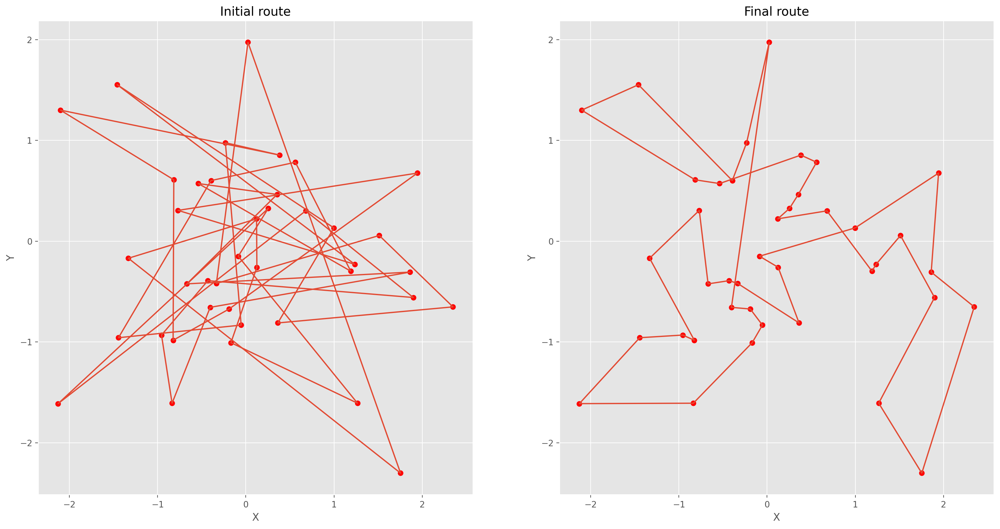

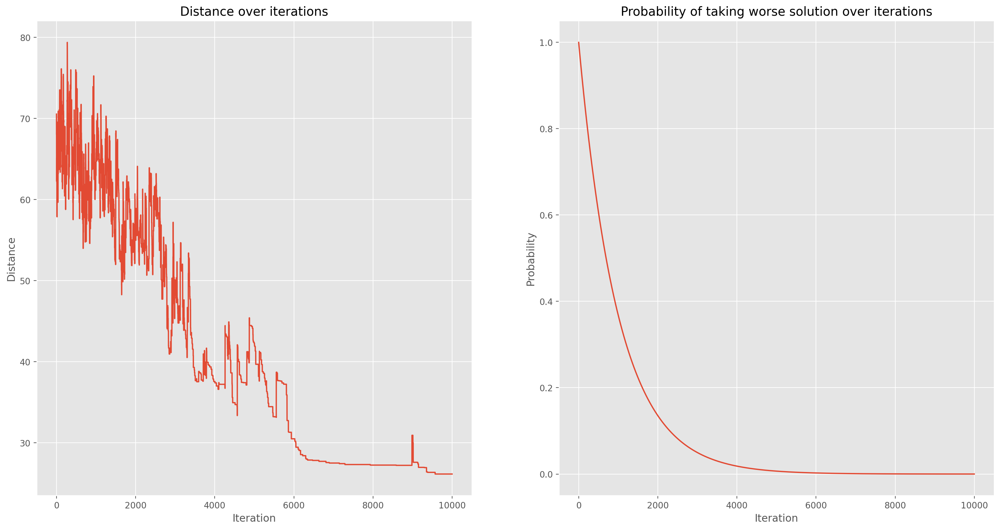

In [14]:
plot_result(normal_dataset_3_p1, 
            *tsp_solver(normal_dataset_3_p1, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000), 
            show_data_charts=True)

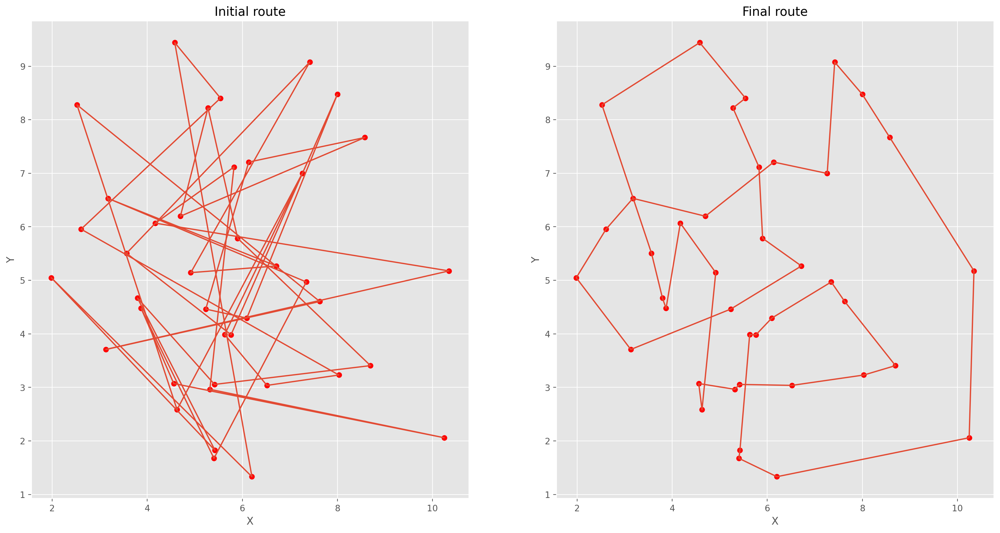

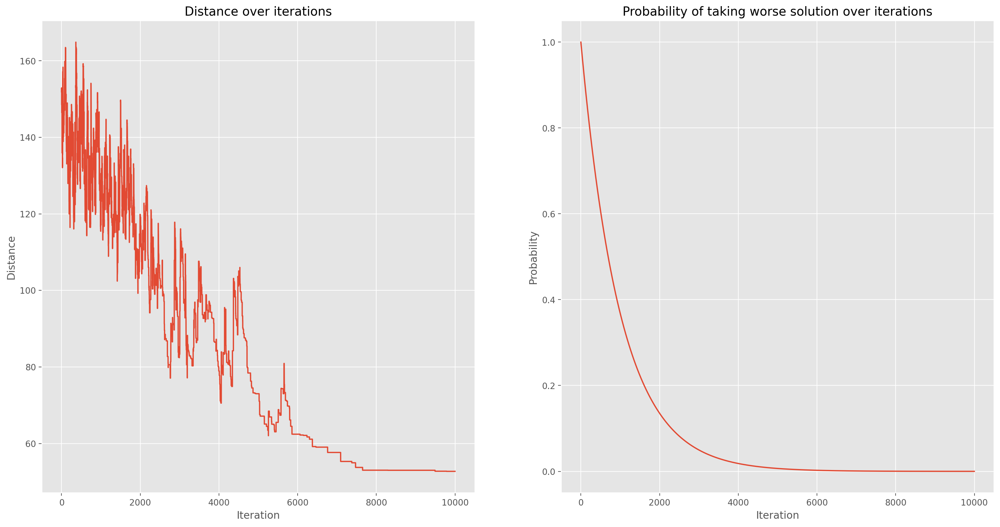

In [15]:
plot_result(normal_dataset_3_p2, 
            *tsp_solver(normal_dataset_3_p2, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL,
                        iterations=10000), 
            show_data_charts=True)

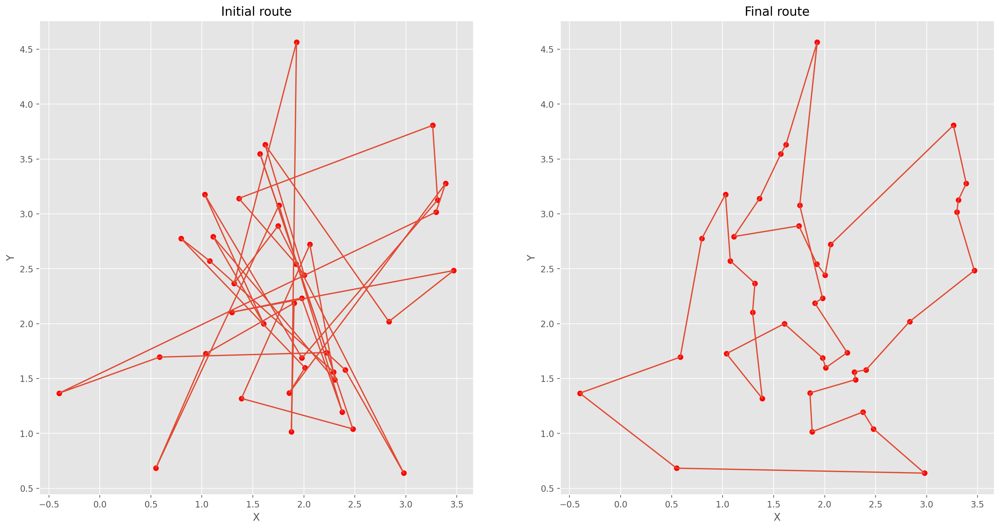

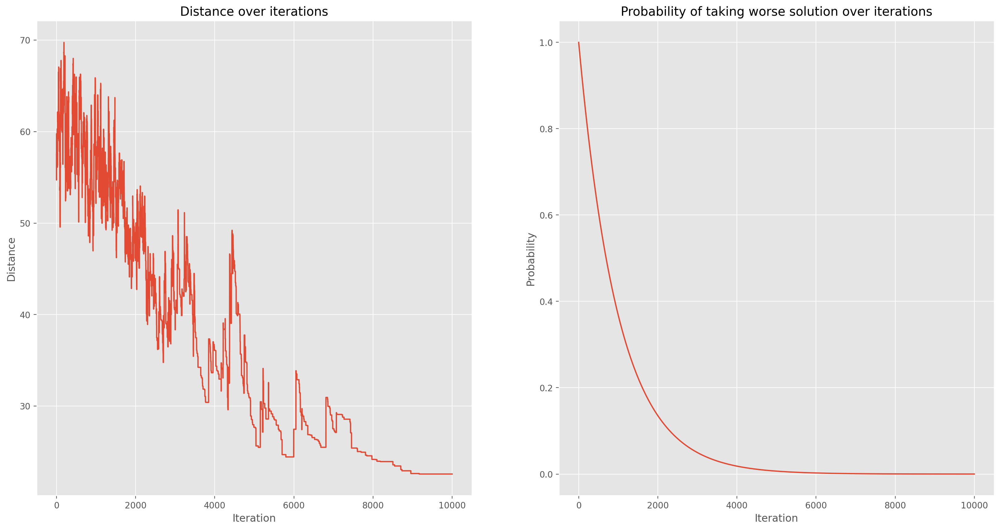

In [16]:
plot_result(normal_dataset_3_p3, 
            *tsp_solver(normal_dataset_3_p3, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000), 
            show_data_charts=True)

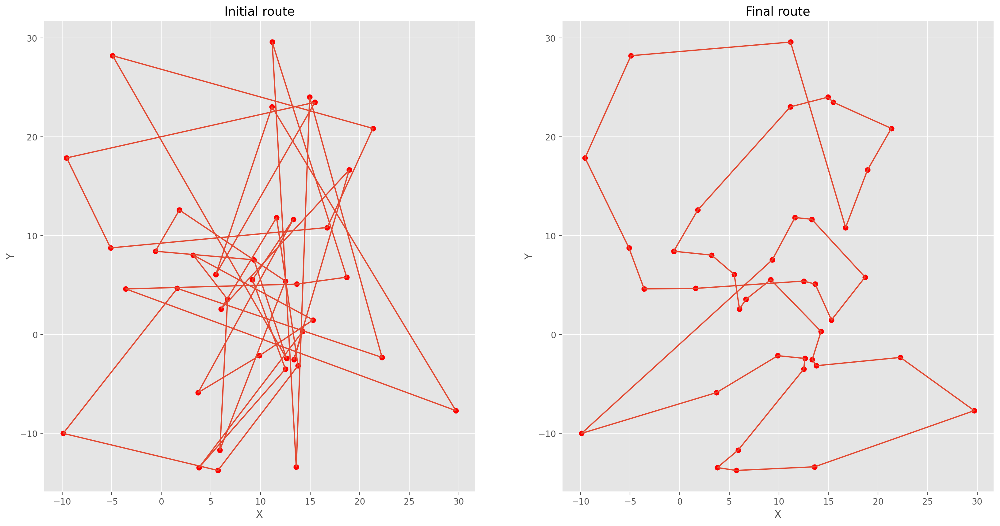

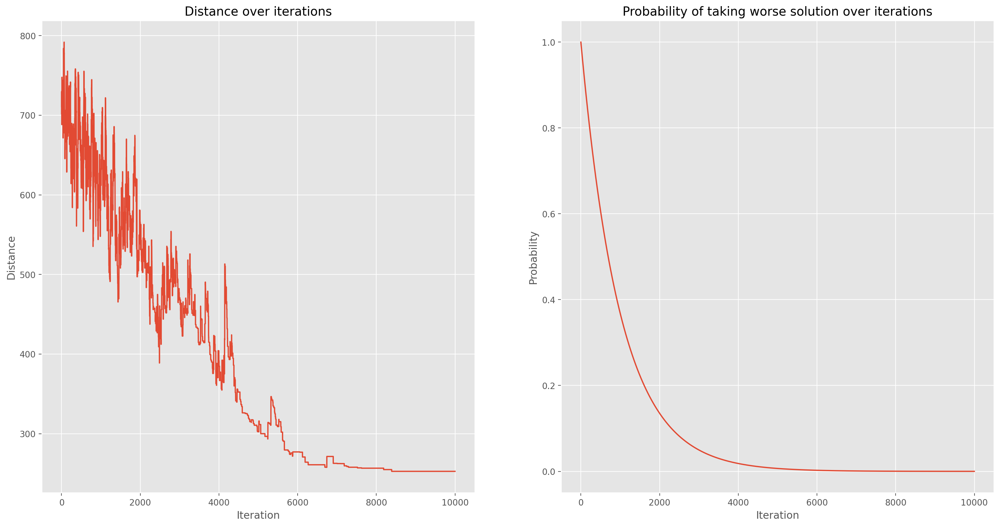

In [17]:
plot_result(normal_dataset_3_p4, 
            *tsp_solver(normal_dataset_3_p4, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000), 
            show_data_charts=True)

#### Rozkład normalny z parametrami $\mu = 8$ i $\sigma = 10$

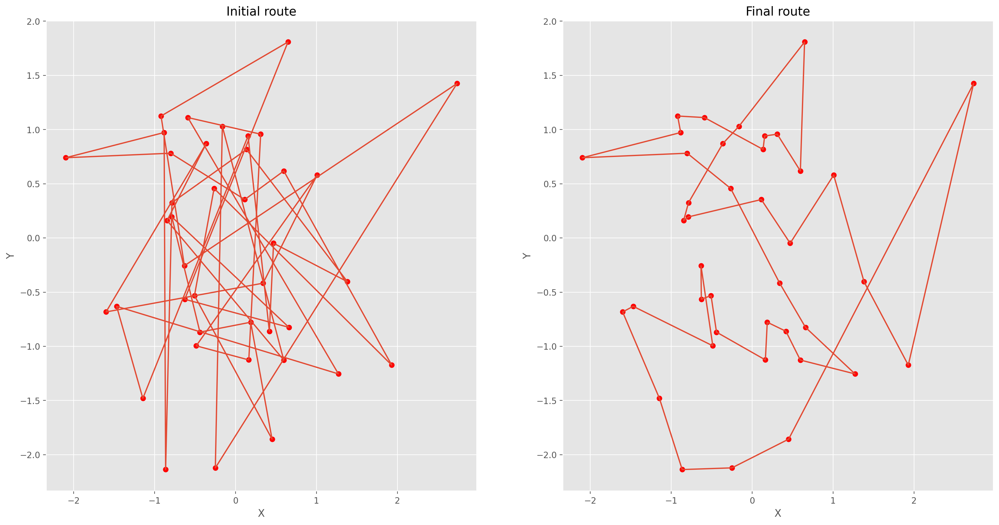

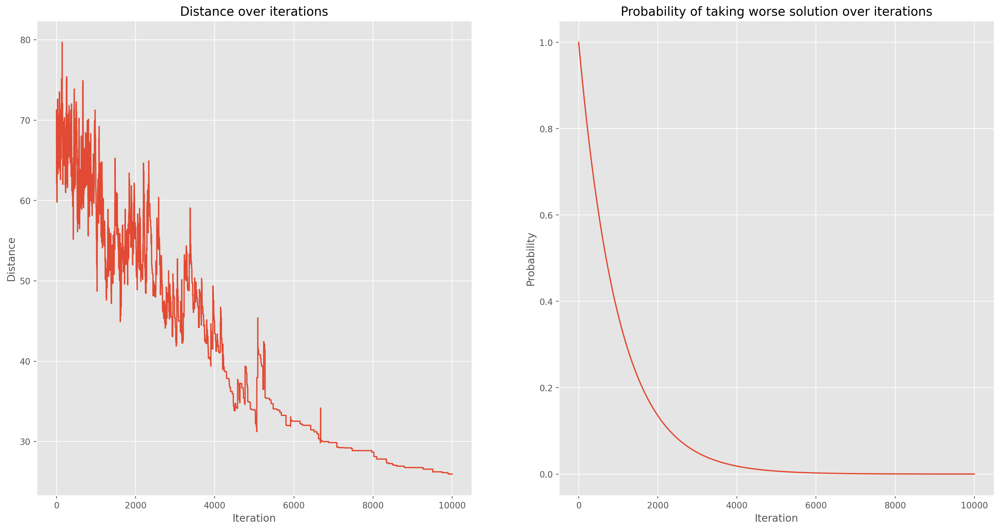

In [18]:
plot_result(normal_dataset_4_p1, 
            *tsp_solver(normal_dataset_4_p1, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000), 
            show_data_charts=True)

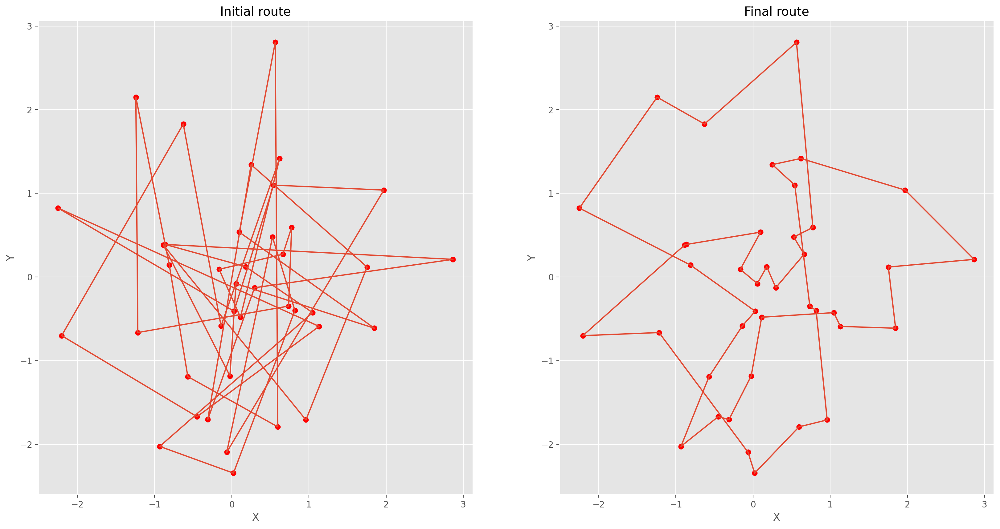

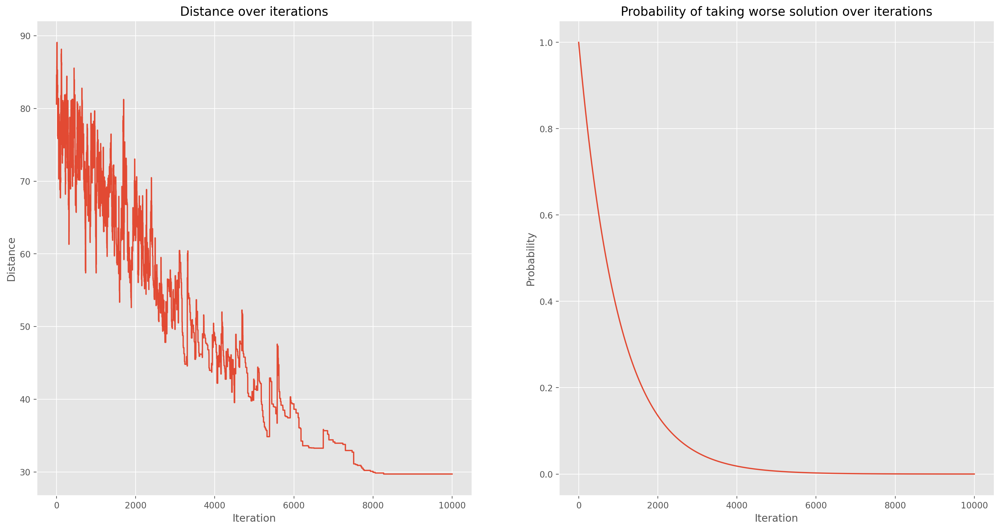

In [19]:
plot_result(normal_dataset_4_p2, 
            *tsp_solver(normal_dataset_4_p2, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL,
                        iterations=10000), 
            show_data_charts=True)

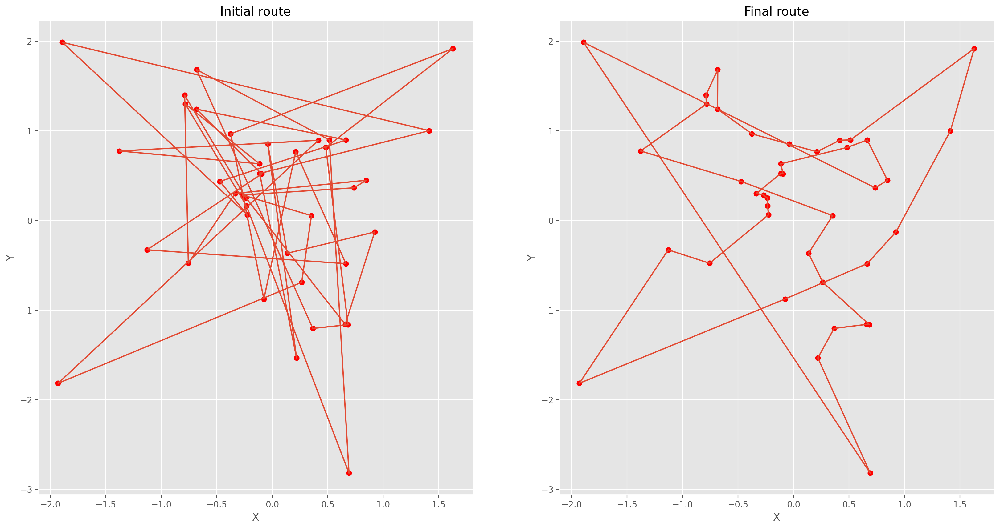

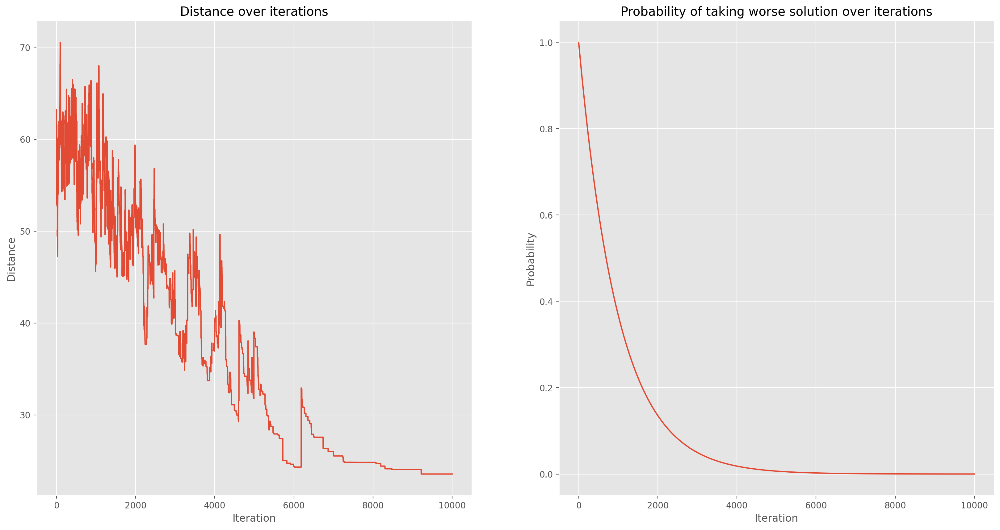

In [20]:
plot_result(normal_dataset_4_p3, 
            *tsp_solver(normal_dataset_4_p3, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000), 
            show_data_charts=True)

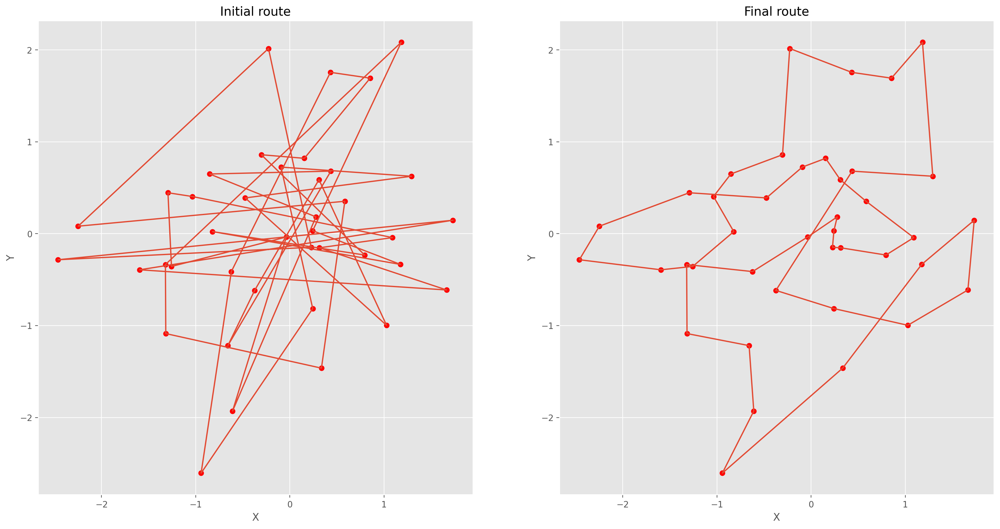

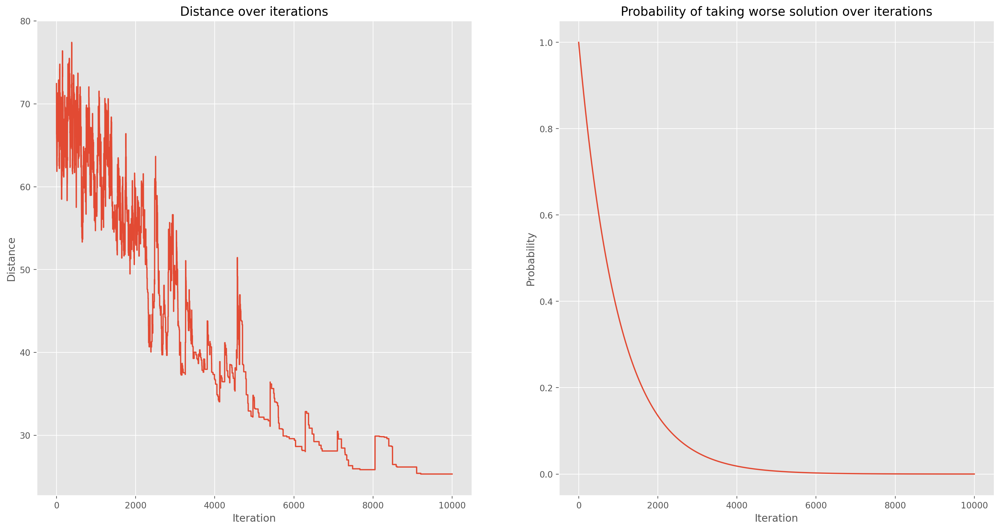

In [21]:
plot_result(normal_dataset_4_p4, 
            *tsp_solver(normal_dataset_4_p4, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000), 
            show_data_charts=True)

#### Rozkłady jednostajne

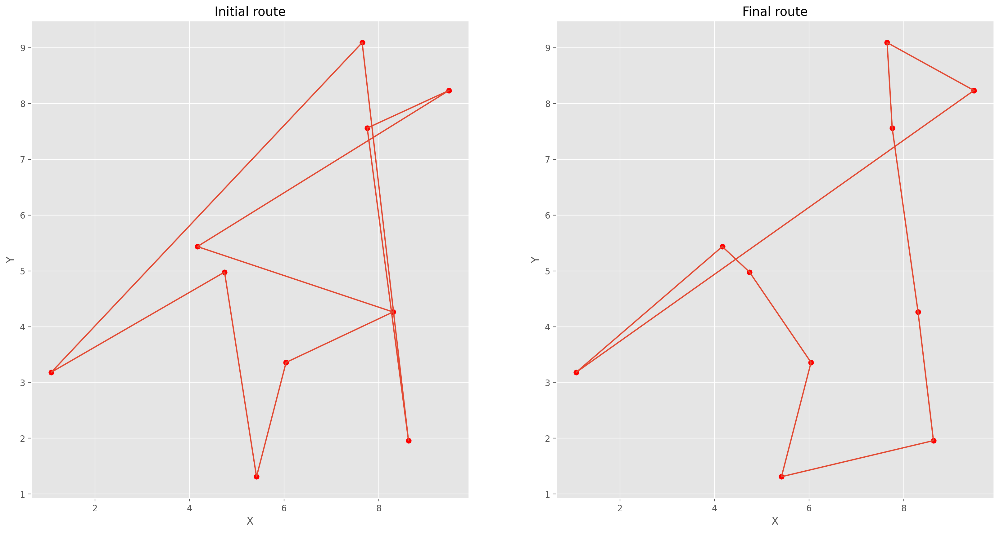

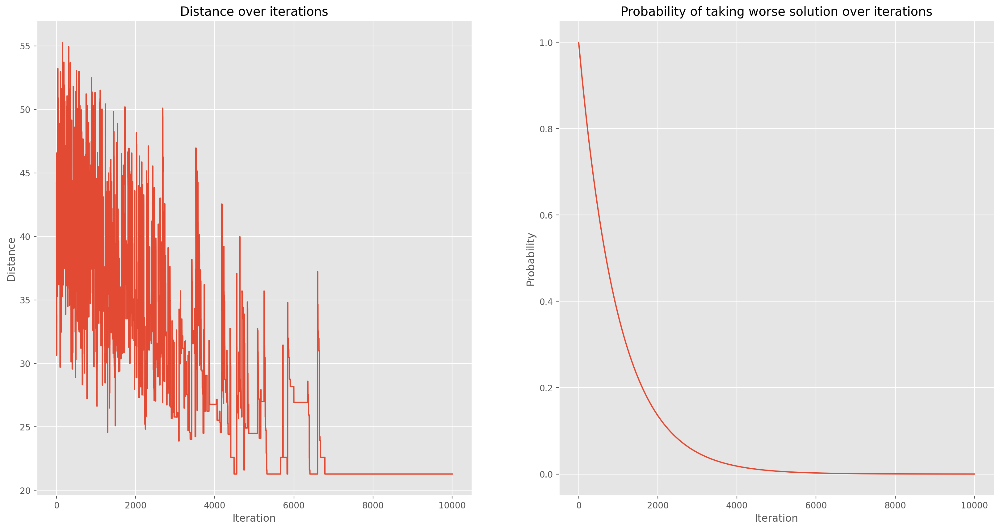

In [22]:
plot_result(uniform_dataset_1, 
            *tsp_solver(uniform_dataset_1, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000), 
            show_data_charts=True)

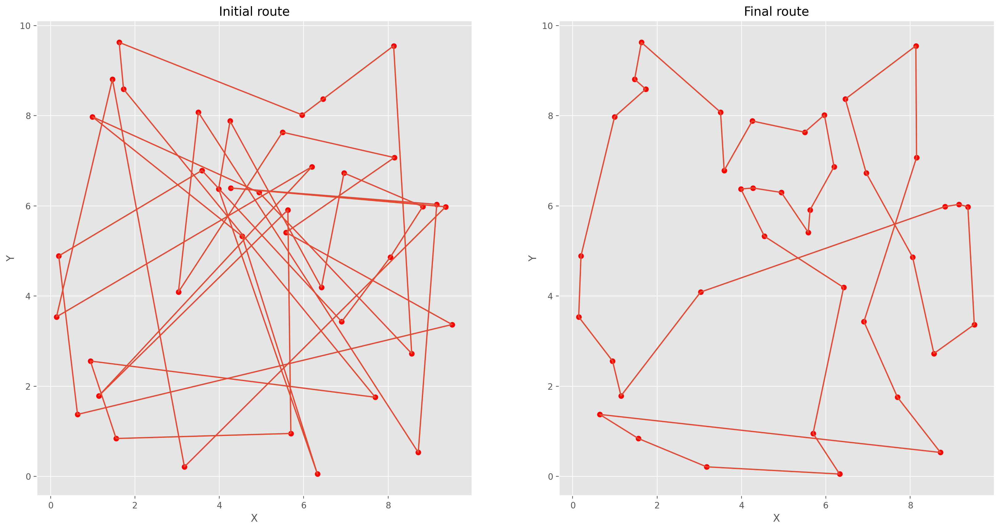

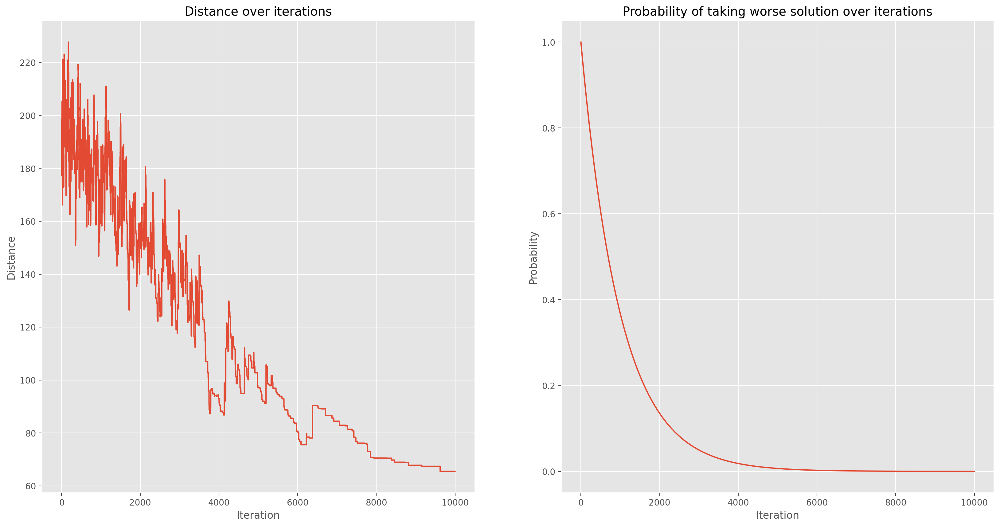

In [23]:
plot_result(uniform_dataset_2, 
            *tsp_solver(uniform_dataset_2, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000),
            show_data_charts=True)

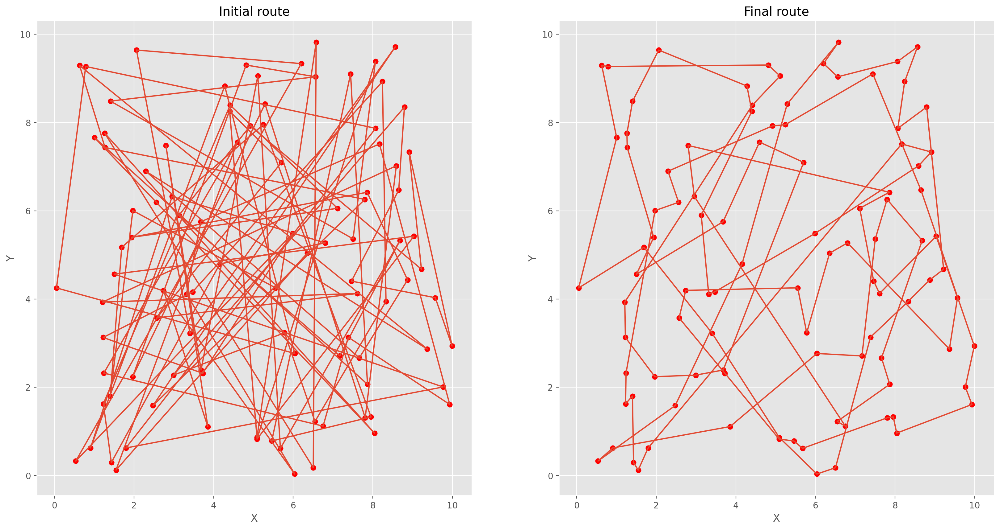

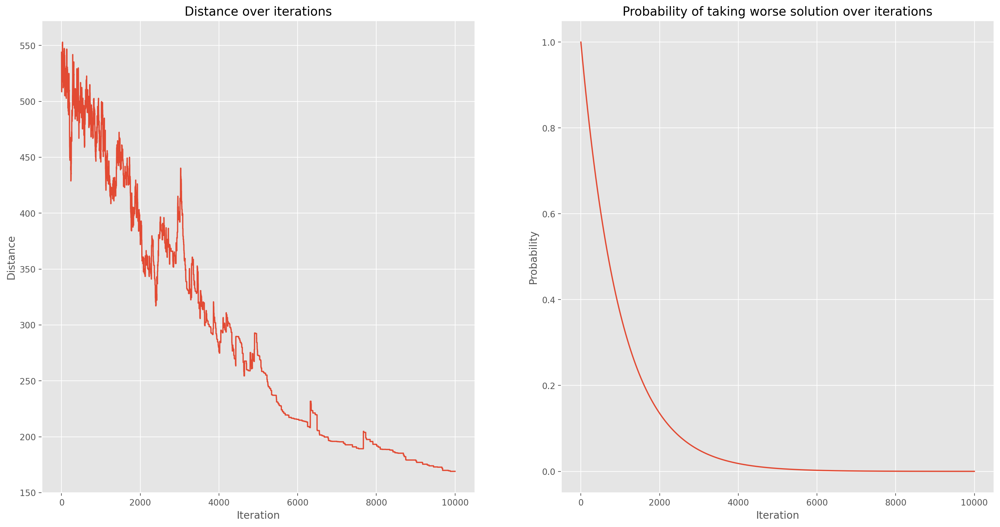

In [24]:
plot_result(uniform_dataset_3, 
            *tsp_solver(uniform_dataset_3, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000), 
            show_data_charts=True)

#### Grupy punktów

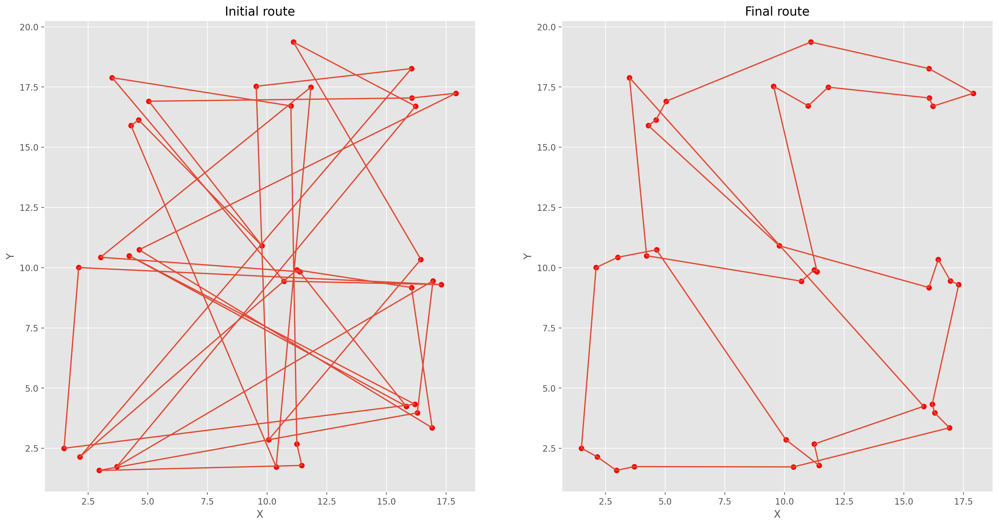

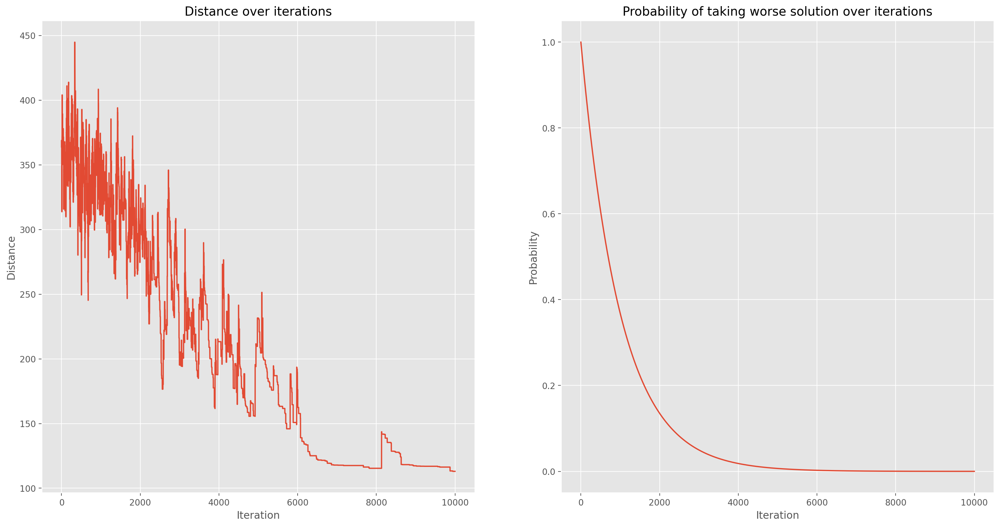

In [25]:
plot_result(group_points_1, 
            *tsp_solver(group_points_1, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000), 
            show_data_charts=True)

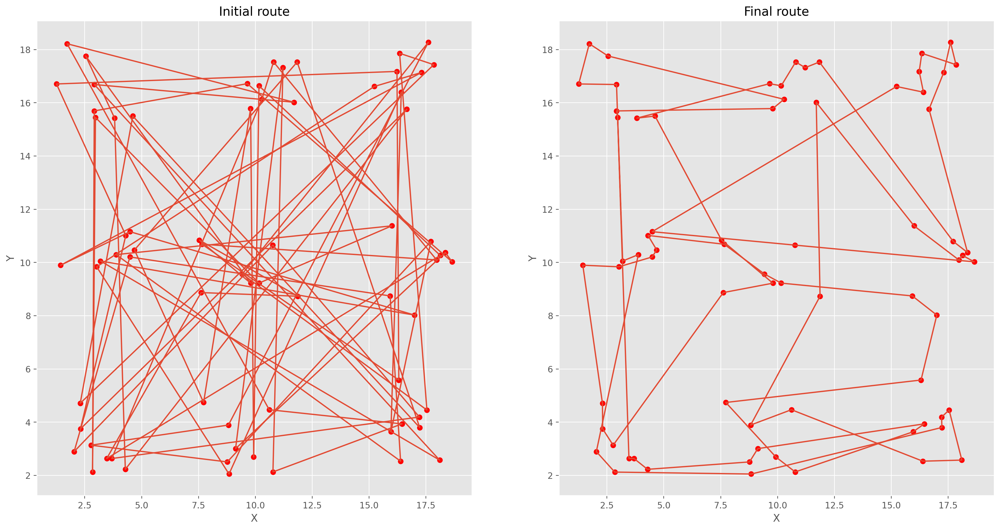

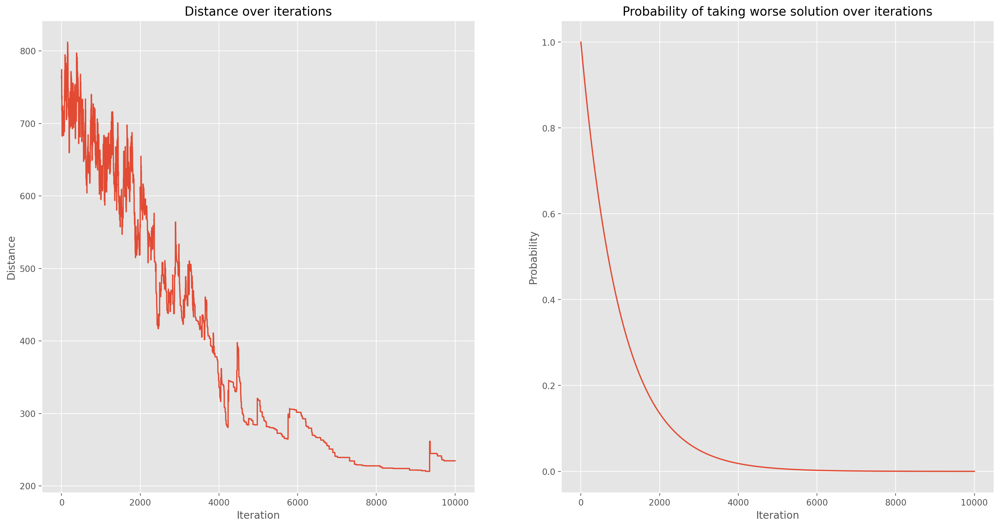

In [26]:
plot_result(group_points_2, 
            *tsp_solver(group_points_2, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL,
                        iterations=10000), 
            show_data_charts=True)

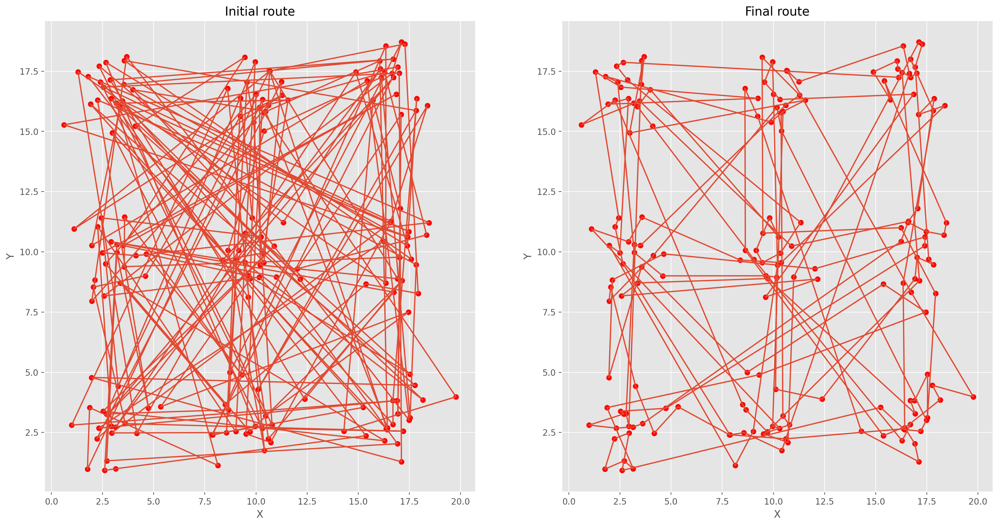

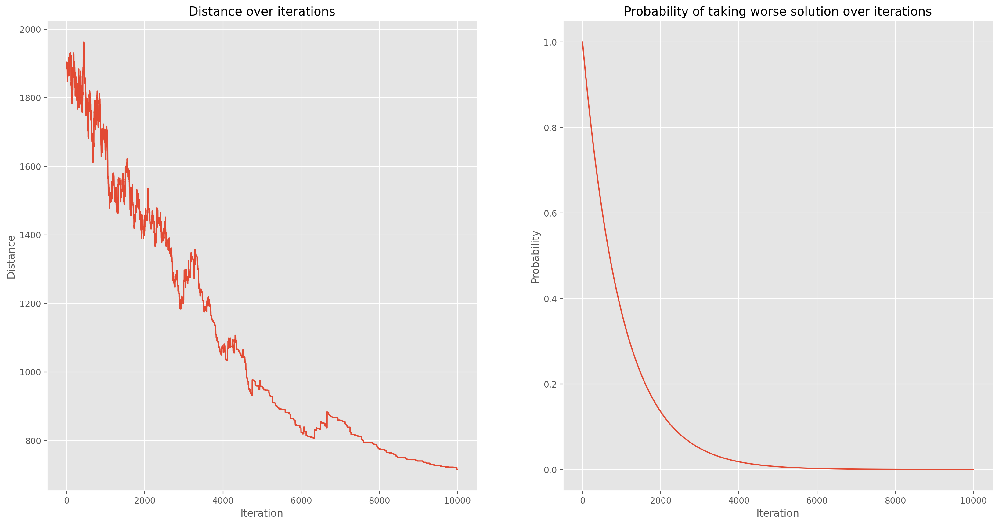

In [27]:
plot_result(group_points_3, 
            *tsp_solver(group_points_3, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000), 
            show_data_charts=True)

Dla każdego zestawu danych możemy zobaczyć, że napisana funkcja działa poprawnie.

### Wpływ sposobu generacji sąsiedniego stanu oraz funkcji zmiany temperatury na wynik

W celu przetestowania różnych metod generowania sąsiednich stanów oraz funkcji zmiany temperatury, zostały wykonane wywołania funkcji `tsp_solver` na zbiorze danych `uniform_dataset_3`.

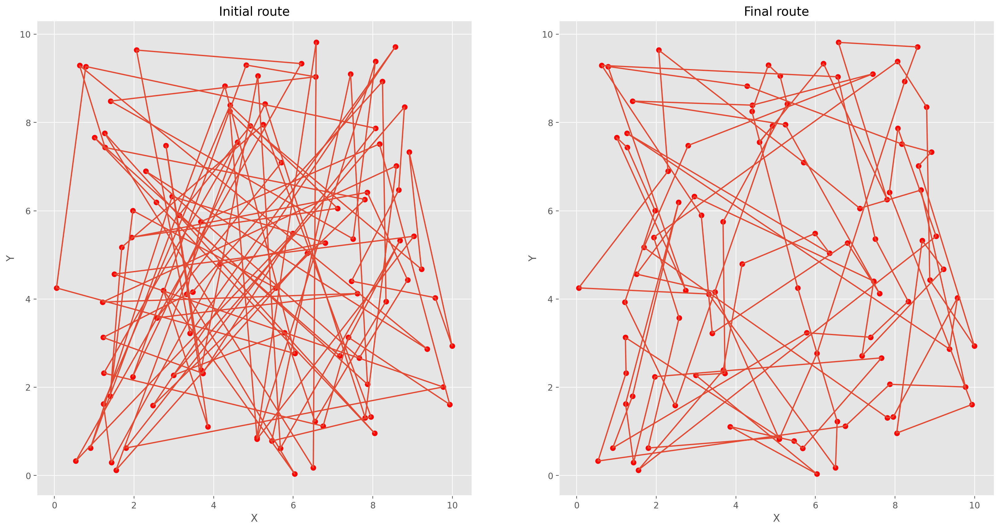

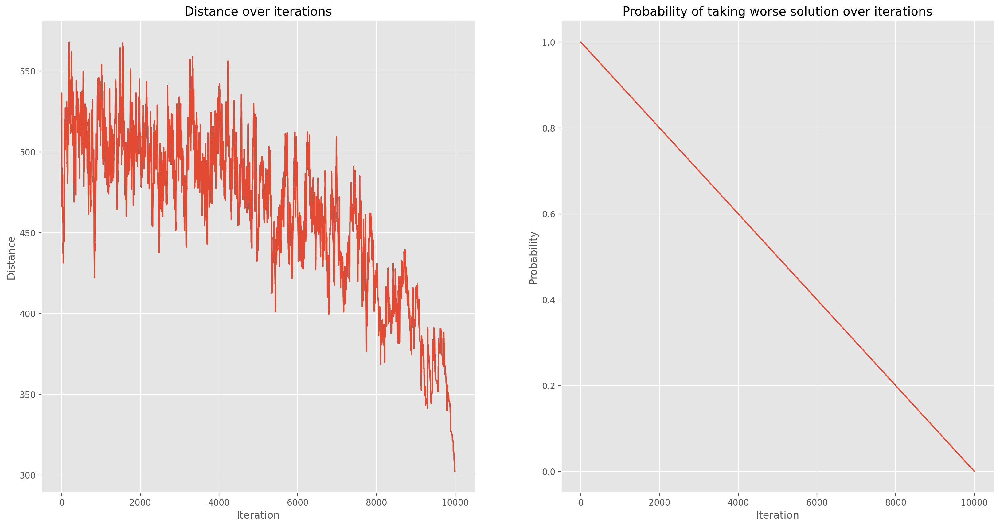

In [28]:
plot_result(uniform_dataset_3, 
            *tsp_solver(uniform_dataset_3, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.LINEAR, 
                        iterations=10000), 
            show_data_charts=True)

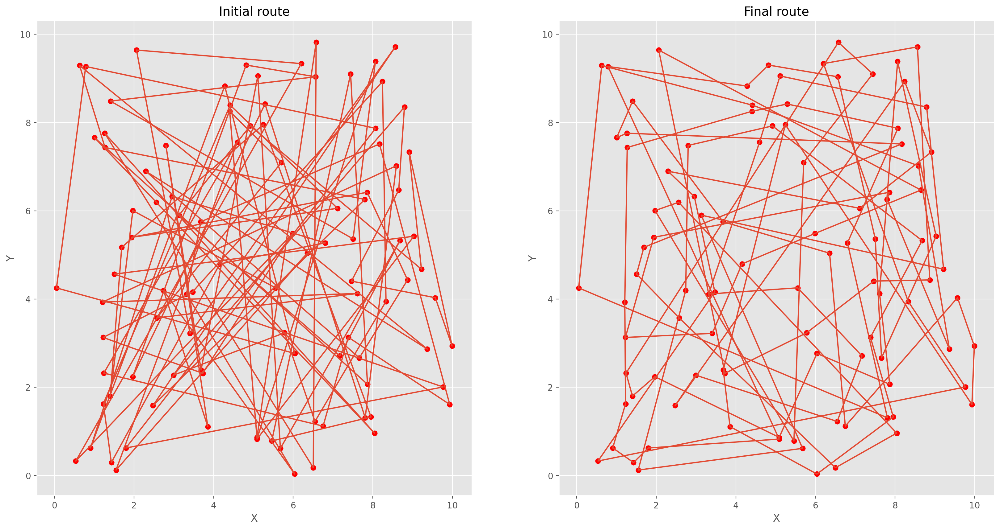

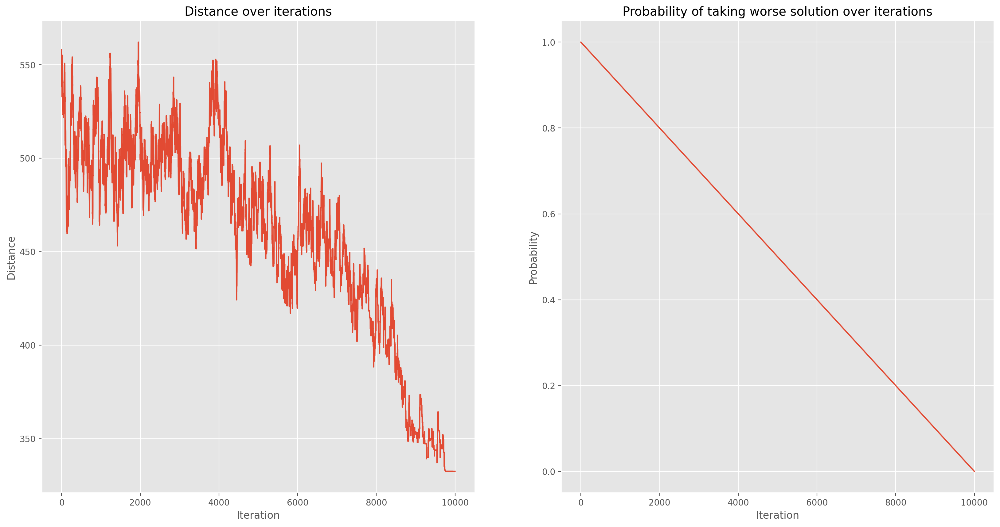

In [29]:
plot_result(uniform_dataset_3, 
            *tsp_solver(uniform_dataset_3, 
                        consecutive_swap=True, 
                        temperature_function=Temperature.LINEAR, 
                        iterations=10000), 
            show_data_charts=True)

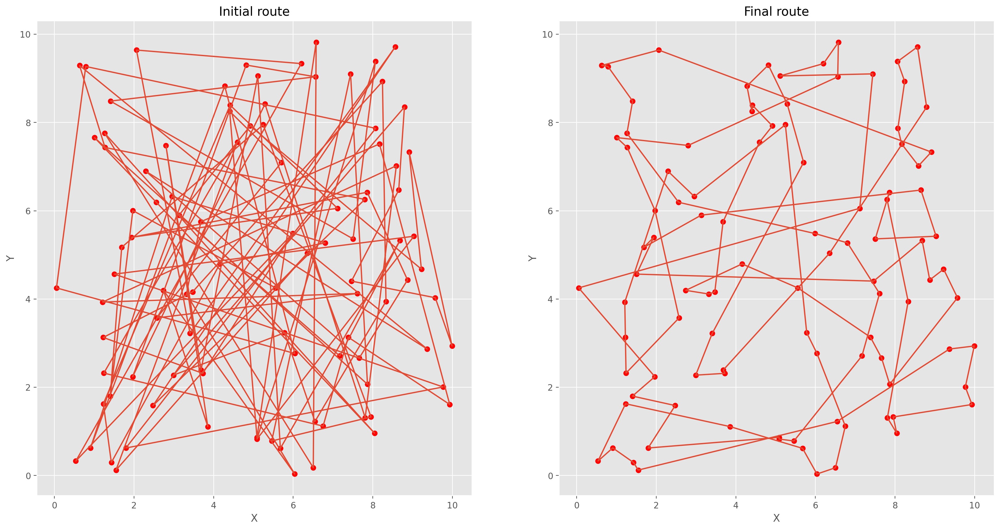

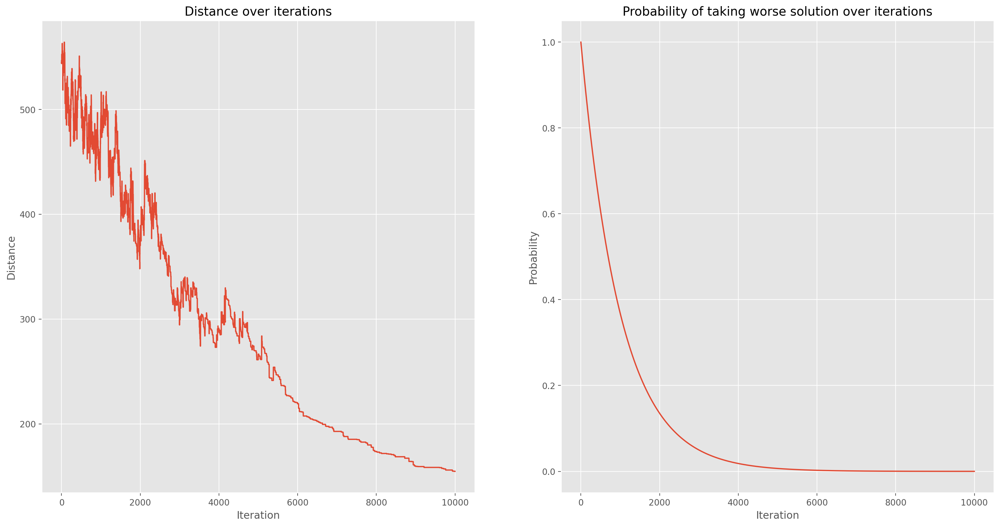

In [30]:
plot_result(uniform_dataset_3, 
            *tsp_solver(uniform_dataset_3, 
                        consecutive_swap=False, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000), 
            show_data_charts=True)

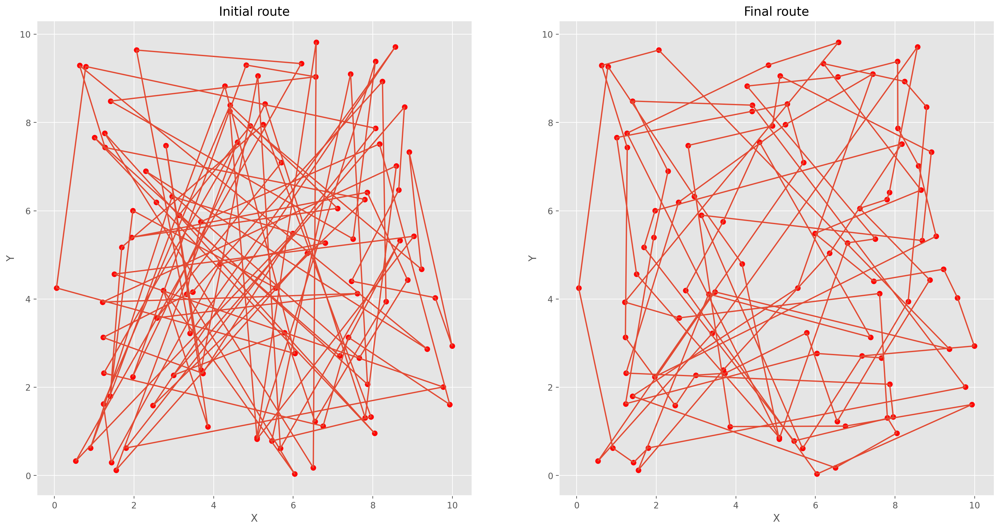

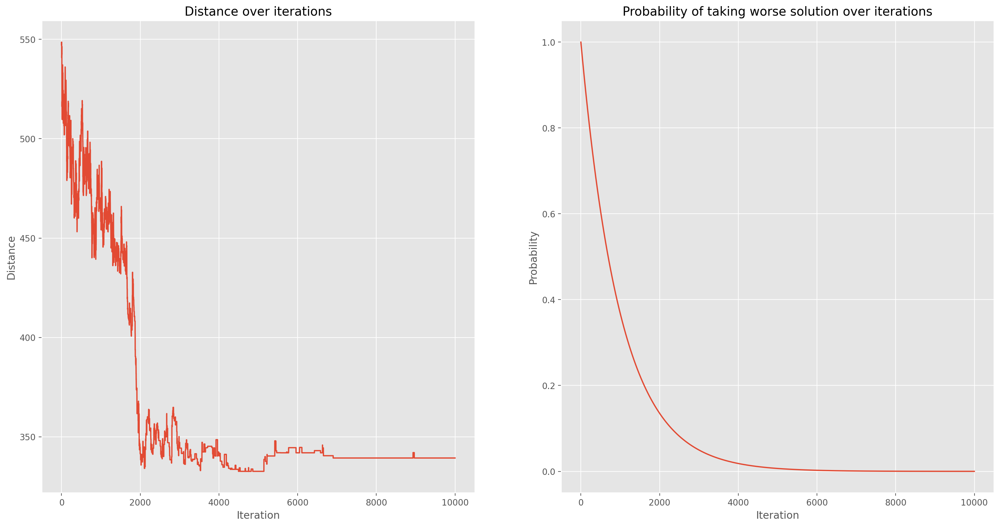

In [31]:
plot_result(uniform_dataset_3, 
            *tsp_solver(uniform_dataset_3, 
                        consecutive_swap=True, 
                        temperature_function=Temperature.EXPONENTIAL, 
                        iterations=10000), 
            show_data_charts=True)

### Wnioski

Dla liniowej funkcji zmiany temperatury wyniki okazały się być gorsze niż dla funkcji eksponencjalnej. Dodatkowo dla tej funkcji możemy zauważyć na wykresach sumy dystansów od iteracji, że wykres ten maleje wolno, w odróżnieniu od funkcji eksponencjalnej. Jest to spowodowane tym, że algorytm przyjmował więcej gorszych aproksymacji przez wolniejsze zmiany temperatury. Arbitrary swap zwracał lepsze wyniki niż consecutive swap, co oznacza że najlepszym wyborem na optymalizację danej funkcji jest wybór metody generacji następnego stanu arbitrary swap wraz z funkcją eksponencjalną zmiany temperatury.

## Zadanie 2 - Obraz binarny

W tym zadaniu należało wygenerować obraz binarny $n \times n$ z wybraną gęstością czarnych punktów. Następnie należało wykorzystać symulowane wyżarzanie do wygenerowania nowego obrazu, który miał powstać na podstawie minimalizacji zaproponowanej funkcji energii (np. przyciąganie się czarnych punktów do białych). Dla poniższych obliczeń została wykorzystana funkcja energii $E_1(x) = x^2$, gdzie x to liczba czarnych punktów w sąsiedztwie badanego punktu oraz funkcje $E_2(x) = \frac{1}{x^2}$, $E_3(x) = ln(x)$ (przy założeniu $x>0$, w przeciwnym przypadku $E_i(x) = 0$). Wszystkie stany sąsiednie mogły być generowane metodą arbitrary swap albo consecutive swap, gdzie losowane były odpowiednie piksele na obrazie. Temperatura mogła być zmieniana liniowo lub funkcją eksponencjalną.

Wykorzystane sąsiedztwa punktów:
- four neighbours - cztery sąsiednie punkty (góra, dół, lewo, prawo)
- four crossed neighbours - cztery sąsiednie punkty na przekątnych
- eight neighbours - punkty otaczające badany punkt
- row neighbours - pięć punktów z lewej i prawej strony badnanego punktu w danym rzędzie
- column neighbours - pięć punktów z lewej i prawej strony badnanego punktu w danej kolumnie
- square 5x5 - wszystkie punkty w kwadracie 5x5

### Implementacja

In [3]:
def generate_binary_image(n=256, p=0.1):
    image = np.random.choice([0, 1], size=(n, n), p=[1 - p, p])
    return image

def plot_binary_result(initial_image, final_image, cost_history, prob_history):
    # Plot initial route
    fig, ax = plt.subplots(1, 2, figsize=(20, 10))
    ax[0].axis('off')
    ax[0].imshow(initial_image, cmap='Greys', interpolation='none')
    ax[1].axis('off')
    ax[1].imshow(final_image, cmap='Greys', interpolation='none')

    plt.show()    
    
    fig, ax = plt.subplots(1, 2, figsize=(20, 10))

    ax[0].plot(cost_history)
    ax[0].set_title('Energy over iterations')
    ax[0].set_xlabel('Iteration')
    ax[0].set_ylabel('Energy')

    ax[1].plot(prob_history)
    ax[1].set_title('Probability of taking worse solution over iterations')
    ax[1].set_xlabel('Iteration')
    ax[1].set_ylabel('Probability')

    plt.show()

def plot_image(dataset):
    fig, ax = plt.subplots()
    ax.axis('off')

    ax.imshow(dataset, cmap='Greys', interpolation='none')
    plt.show()

class Energy():
    FOUR_NEIGHBOURS=1
    FOUR_CROSS_NEIGHBOURS=2
    EIGHT_NEIGHBOURS=3
    COLUMN_NEIGHBOURS=4
    ROW_NEIGHBOURS=5
    SQUARE_5X5=6

    def __init__(self, image, func = lambda x: 5*x*x if x>0 else 0, neighbourhood=None) -> None:
        self.func = func
        self.image = image

        if neighbourhood == Energy.FOUR_NEIGHBOURS:
            self.neighbourhood = self.four_neighbours
        elif neighbourhood == Energy.FOUR_CROSS_NEIGHBOURS:
            self.neighbourhood = self.cross_four_neighbours
        elif neighbourhood == Energy.EIGHT_NEIGHBOURS:
            self.neighbourhood = self.eight_neighbours
        elif neighbourhood == Energy.COLUMN_NEIGHBOURS:
            self.neighbourhood = self.column_neighbours
        elif neighbourhood == Energy.ROW_NEIGHBOURS:
            self.neighbourhood = self.row_neighbours
        elif neighbourhood == Energy.SQUARE_5X5:
            self.neighbourhood = self.square5x5
        else:
            self.neighbourhood = self.four_neighbours
        
        # Calculate number of black pixels in neighbourhood
        self.neighbours_count = np.zeros((len(image), len(image)))
        self.neighbours_coords = {}
        for i in range(len(image)):
            for j in range(len(image)):
                # Count neighbours
                self.neighbours_count[(i, j)] = sum([image[x][y] for x, y in self.neighbourhood(i, j)])
                self.neighbours_coords[(i, j)] = [(x, y) for x, y in self.neighbourhood(i, j)]
                    
    def energy(self, i, j, add_value=0):
        return self.func(self.neighbours_count[(i, j)]+add_value)    
    
    def calculate_whole_energy(self, image):
        energy = 0
        for i in range(len(image)):
            for j in range(len(image)):
                energy += self.energy(i, j)
        return energy
    
    def calculate_fit_difference(self,image, p1, p2):
        if image[p1] == image[p2]:
            return 0

        # Get neighbours of p1
        neighbours1 = self.neighbours_coords[p1]
        # Get neighbours of p2
        neighbours2 = self.neighbours_coords[p2]

        # Get common neighbours
        common_neighbours = set(neighbours1).intersection(set(neighbours2))
        neighbours1 = list(filter(lambda x: x not in common_neighbours, neighbours1))
        neighbours2 = list(filter(lambda x: x not in common_neighbours, neighbours2))

        filtered_neighbours = neighbours1 + neighbours2

        current_fit = sum([self.energy(x, y) for x, y in filtered_neighbours])

        # Calculate fit after swap
        change = 1 if image[p1[0]][p1[1]] == 0 else -1

        after_change = sum([self.energy(x, y, change) for x, y in neighbours1]) + sum([self.energy(x, y, -change) for x, y in neighbours2])

        if p1 in neighbours2:
            current_fit += self.energy(p1[0], p1[1]) + self.energy(p2[0], p2[1])

            after_change += self.energy(p1[0], p1[1], -change) + self.energy(p2[0], p2[1], change)

        return current_fit - after_change
    
    def update_neighbours(self, image, p1,p2):
        if image[p1] == image[p2]:
            return 0
        
        # Get neighbours of p1
        neighbours1 = self.neighbours_coords[p1]
        # Get neighbours of p2
        neighbours2 = self.neighbours_coords[p2]
    
        change = 1 if image[p1[0]][p1[1]] == 0 else -1
        for neighbour in neighbours1:
            self.neighbours_count[neighbour] += change

        for neighbour in neighbours2:
            self.neighbours_count[neighbour] -= change

        image[p1], image[p2] = image[p2], image[p1]

    def four_neighbours(self, i, j):
        if i > 0:
            yield i-1, j
        if i < len(self.image) - 1:
            yield i+1, j
        if j > 0:
            yield i, j-1
        if j < len(self.image) - 1:
            yield i, j+1

    def cross_four_neighbours(self,i,j):
        if i > 0 and j > 0:
            yield i-1, j-1
        if i > 0 and j < len(self.image) - 1:
            yield i-1, j+1
        if i < len(self.image) - 1 and j > 0:
            yield i+1, j-1
        if i < len(self.image) - 1 and j < len(self.image) - 1:
            yield i+1, j+1

    def eight_neighbours(self,i,j):
        for x, y in self.four_neighbours(i, j):
            yield x, y
        for x, y in self.cross_four_neighbours(i, j):
            yield x, y

    def twelve_neighbours(self,i,j):
        for x, y in self.eight_neighbours(i, j):
            yield x, y
        if i > 1:
            yield i-2, j
        if i < len(self.image) - 2:
            yield i+2, j
        if j > 1:
            yield i, j-2
        if j < len(self.image) - 2:
            yield i, j+2

    def column_neighbours(self,i,j):
        for x in range(5):
            if i+x < len(self.image):
                yield i+x, j
            
            if i-x >= 0:
                yield i-x, j

    def row_neighbours(self,i,j):
        for x in range(5):
            if j+x < len(self.image):
                yield i, j+x
            
            if j-x >= 0:
                yield i, j-x

    def square5x5(self,i,j):
        for y in range(max(0, i-5), min(i+5, len(self.image))):
            for x in range(max(0, i-5), min(i+5, len(self.image[0]))):
                if x != i and y != j:
                    yield (x, y)

               
def binary_image_solver(dataset, consecutive_swap=True, temperature_function=Temperature.EXPONENTIAL, iterations = 100000, delta=None, func=lambda x: x*x if x>0 else 0, neighbourhood=Energy.FOUR_NEIGHBOURS):
    # Generate initial route
    image = dataset.copy()
    best_image = image.copy()
    n = len(image) ** 2

    energy = Energy(image, func, neighbourhood)
    # Get cost of initial route
    current_fitness = energy.calculate_whole_energy(image)
    best_fitness = current_fitness

    # Run simmulated annealing to optimize cost of path
    T = Temperature(iterations, temperature_function, delta)
    prob_history = []
    fitness_history = []
    point_range = list(range(n))
    for i in range(iterations):
        # Get random points
        p1, p2 = np.random.choice(point_range, size=2)
        
        if consecutive_swap:
            p2 = (p1 + 1) % n

        p1 = (p1 // len(image), p1 % len(image))
        p2 = (p2 // len(image), p2 % len(image))

        # Candidate route
        fit_difference = energy.calculate_fit_difference(image, p1, p2)

        prob_history.append(T.probability)

        if fit_difference > 0 or np.random.uniform(0, 1) < T.probability: 
            energy.update_neighbours(image, p1, p2)
            current_fitness -= fit_difference
            if current_fitness < best_fitness:
                best_image = image.copy()
                best_fitness = current_fitness

        T.cool_down()
        fitness_history.append(current_fitness)

    return best_image, fitness_history, prob_history 

### Wyniki w zależności od rodzaju sąsiedztwa i spadku temperatury

W celu zbadania zależności, wygenerowano obrazy o rozmiarze $128 \times 128$ o gęstości czarnych punktów $0.25$ (dla tej gęstości wychodziły najlepsze wyniki). Następnie dla każdego obrazu wykonano $10^5$ iteracji dla każdego rodzaju sąsiedztwa i funkcji zmiany temperatury. Jako funkcję energii wykorzystano $E_1(x) = x^2$. Następne stany były generowane metodą arbitrary swap.

#### Four neighbours

Czarne punkty utworzyły równomierne, małe grupy punktów. 

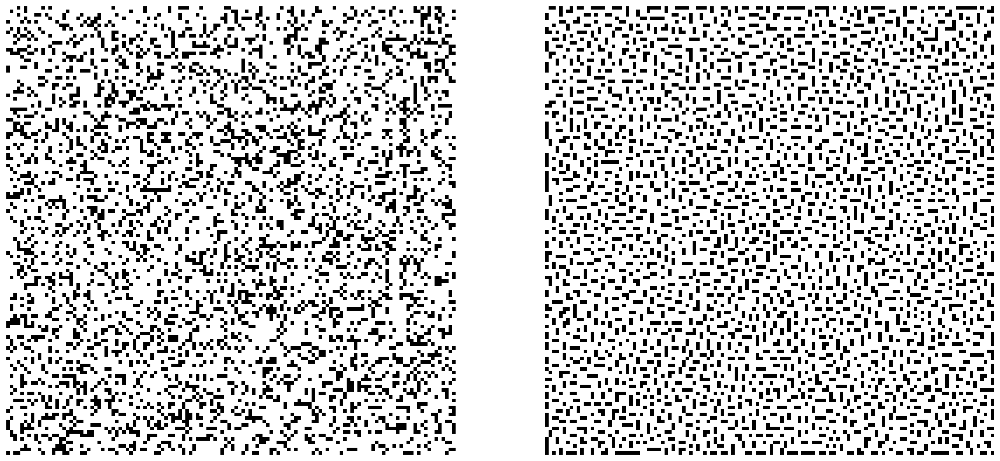

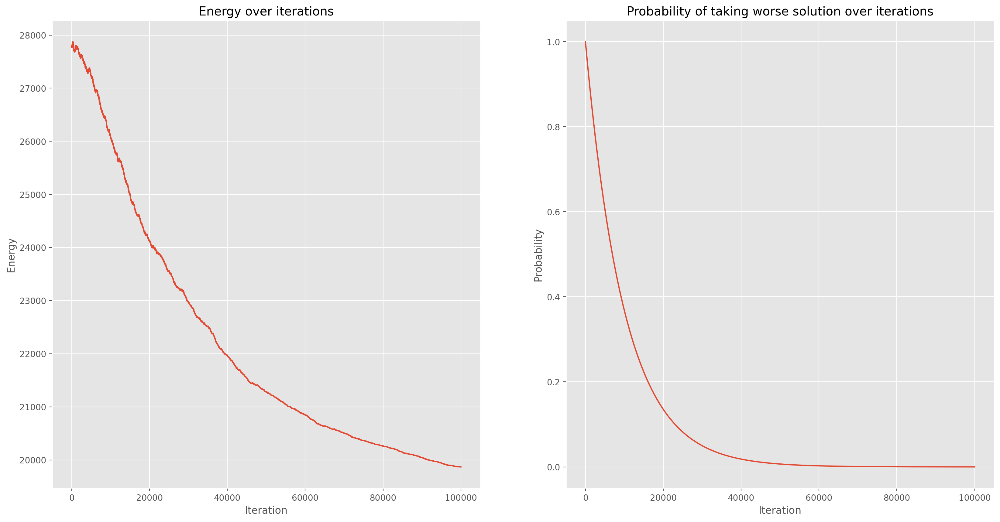

In [33]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=False, 
                                  temperature_function=Temperature.EXPONENTIAL, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.FOUR_NEIGHBOURS)
plot_binary_result(dataset, img, fh, ph)

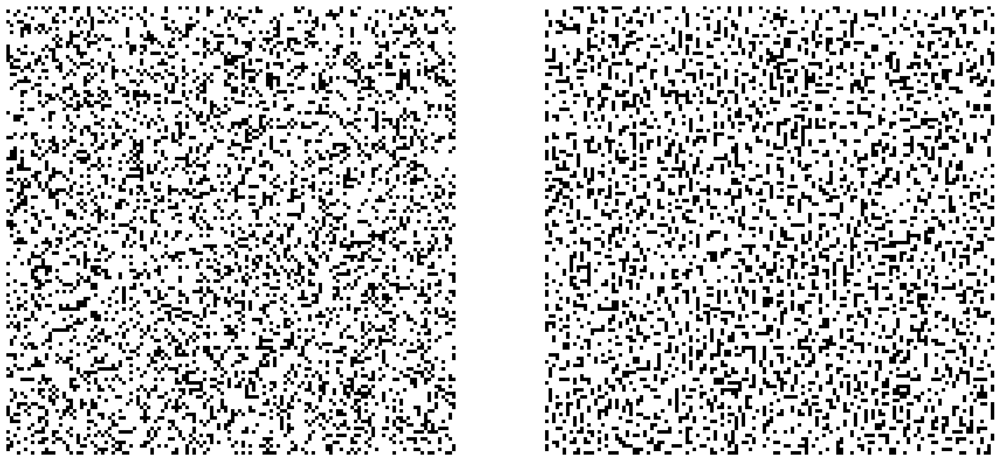

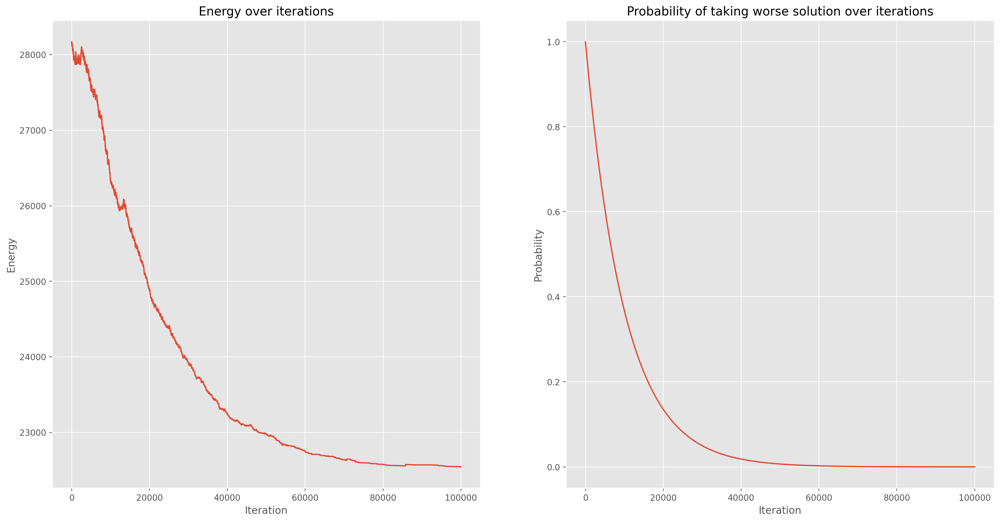

In [34]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=True, 
                                  temperature_function=Temperature.EXPONENTIAL, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.FOUR_NEIGHBOURS)
plot_binary_result(dataset, img, fh, ph)

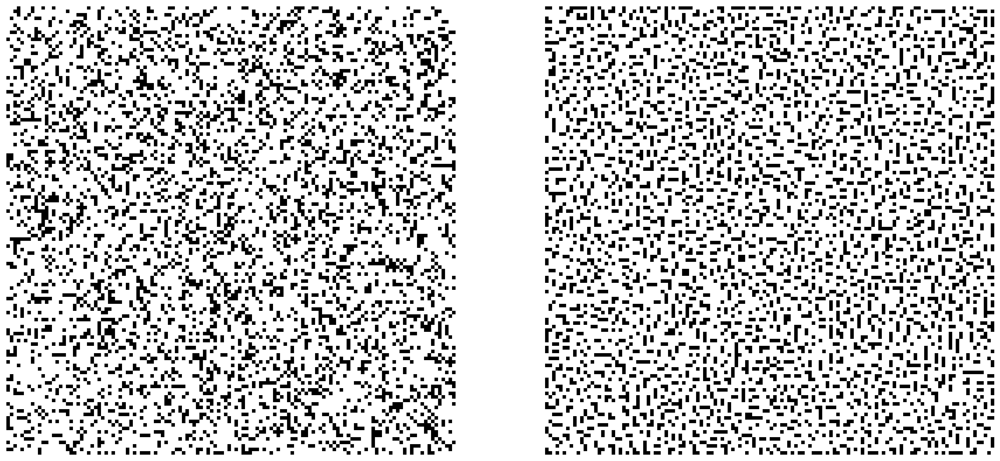

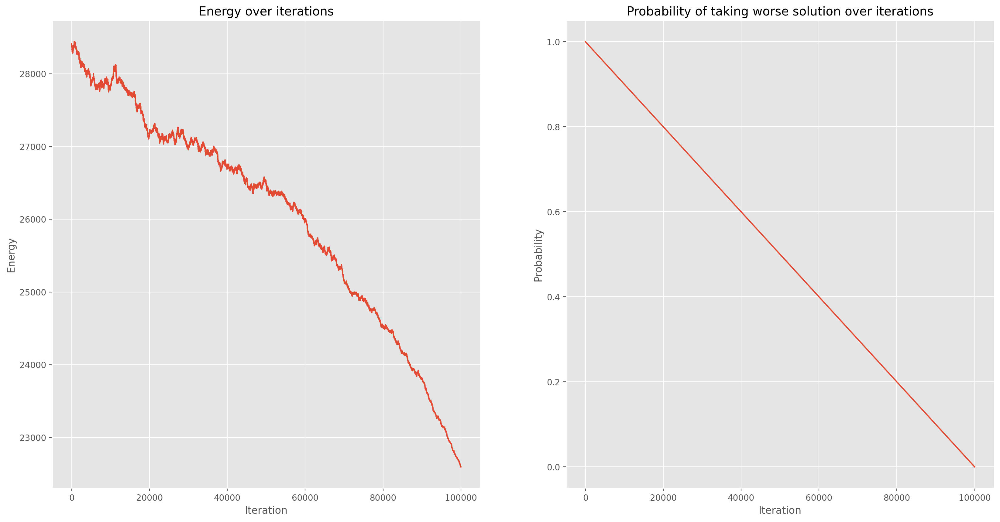

In [35]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=False, 
                                  temperature_function=Temperature.LINEAR, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.FOUR_NEIGHBOURS)
plot_binary_result(dataset, img, fh, ph)

#### Four crossed neighbours

Czarne punkty utworzyły równomierne, małe grupy punktów. 

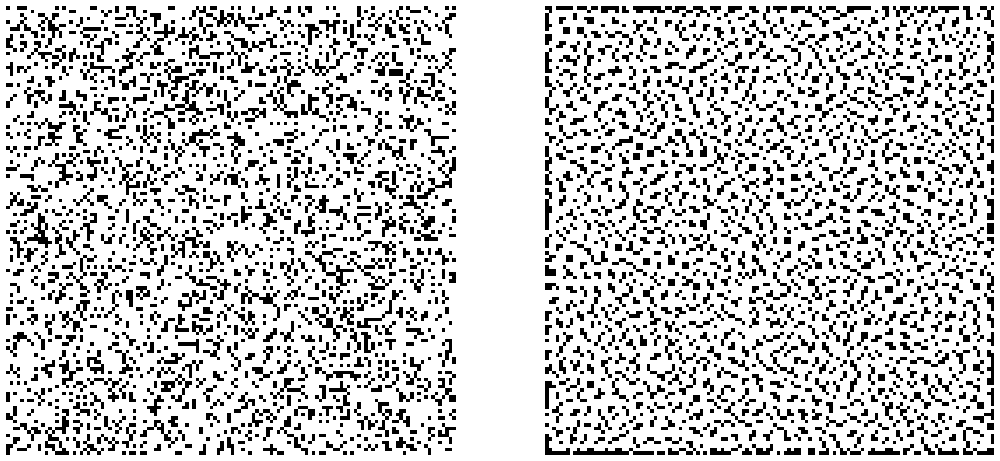

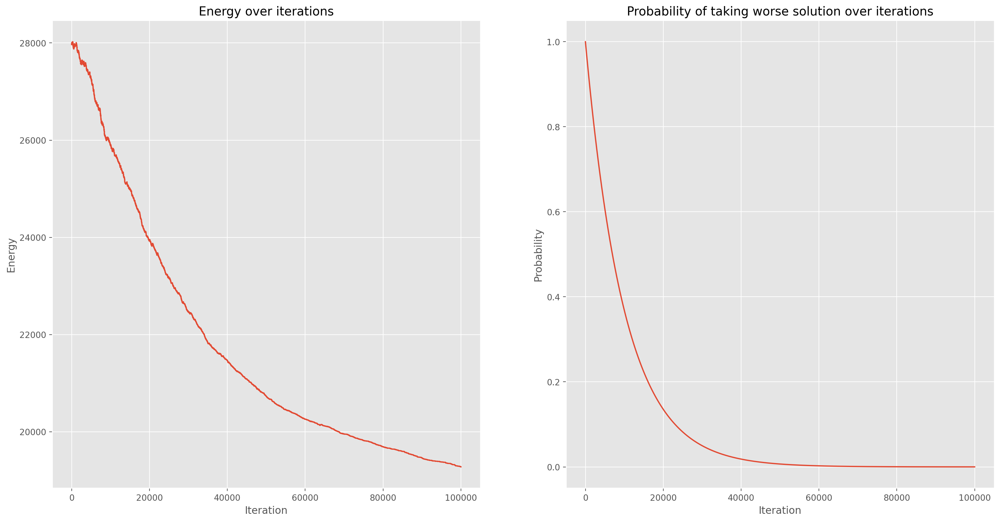

In [36]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=False, 
                                  temperature_function=Temperature.EXPONENTIAL, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.FOUR_CROSS_NEIGHBOURS)
plot_binary_result(dataset, img, fh, ph)

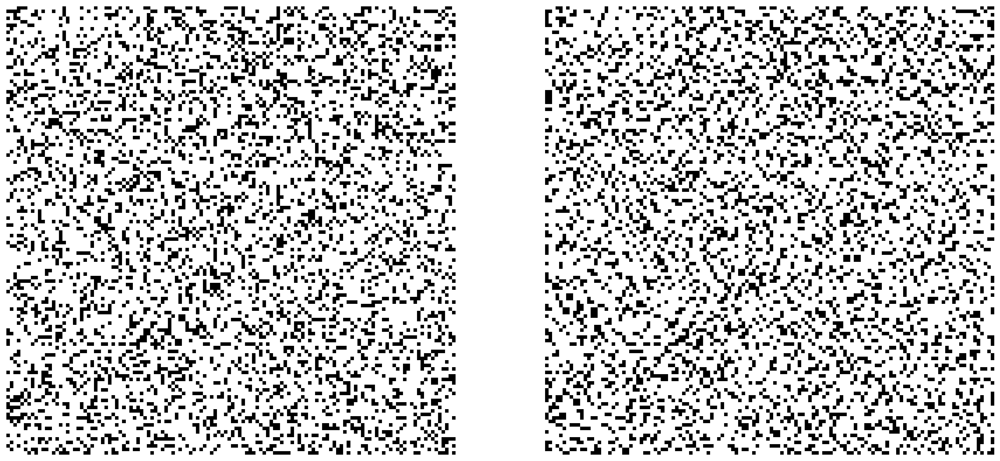

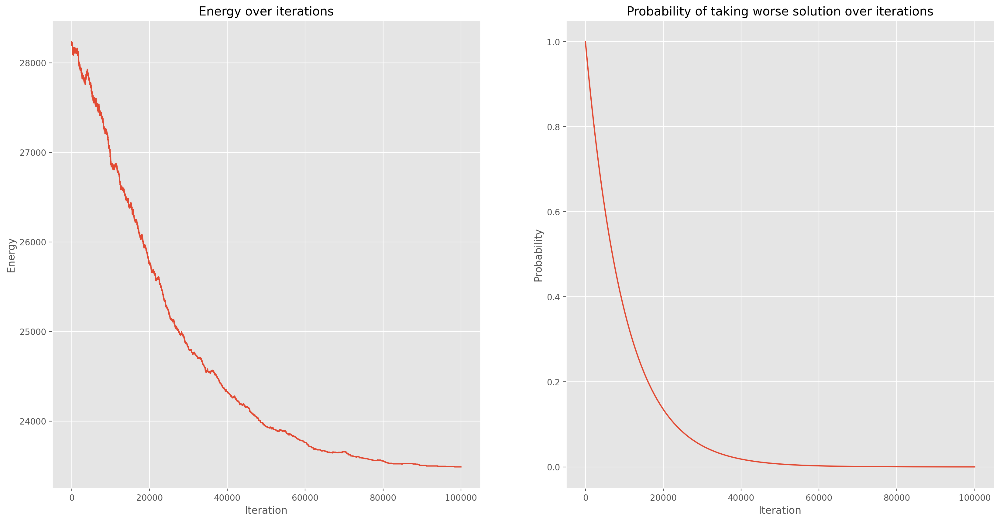

In [37]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=True, 
                                  temperature_function=Temperature.EXPONENTIAL, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.FOUR_CROSS_NEIGHBOURS)
plot_binary_result(dataset, img, fh, ph)

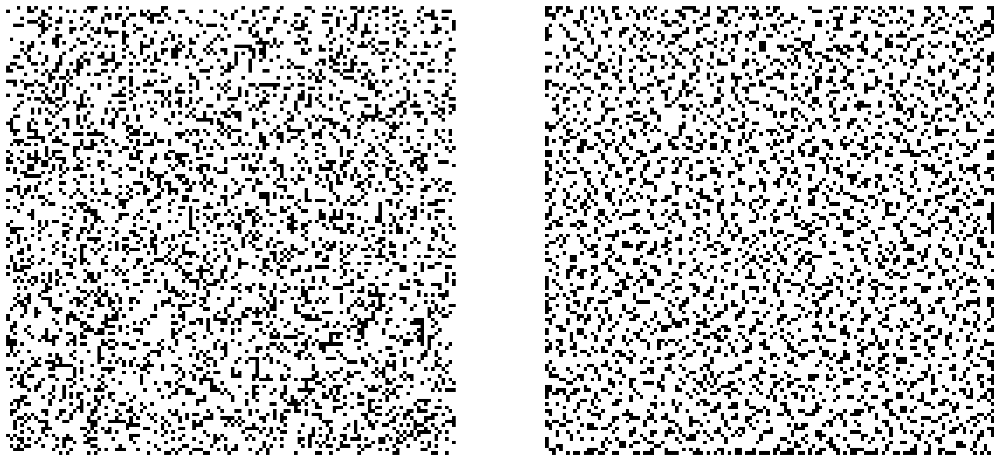

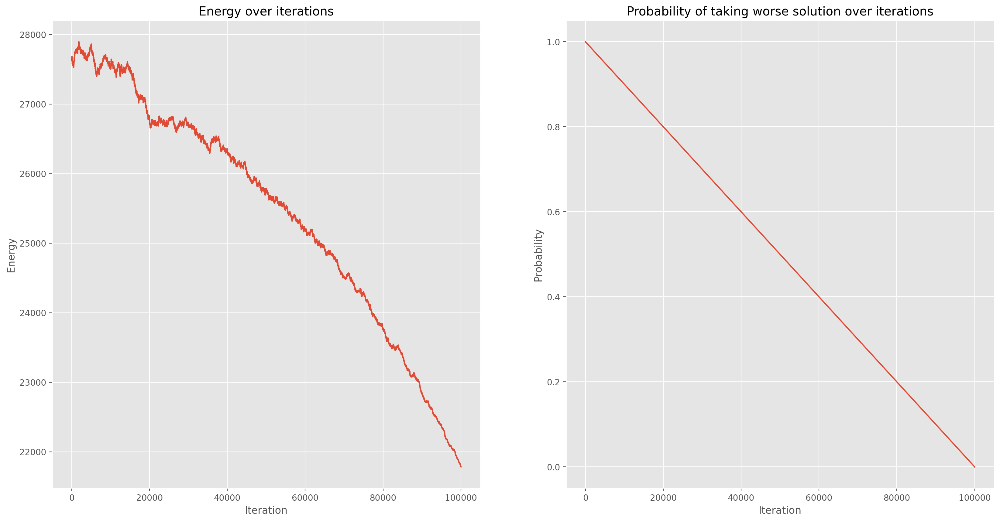

In [38]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=False, 
                                  temperature_function=Temperature.LINEAR, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.FOUR_CROSS_NEIGHBOURS)
plot_binary_result(dataset, img, fh, ph)

#### Eight neighbours

Czarne punkty utworzyły równomierne, małe grupy punktów. , które są bardziej odległe od siebie niż dla sąsiedztw four neighbours oraz four crossed neighbours.

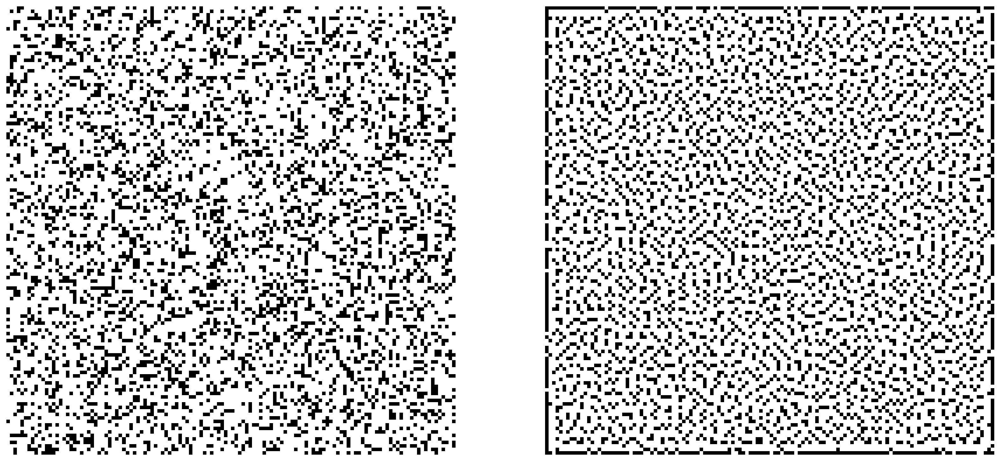

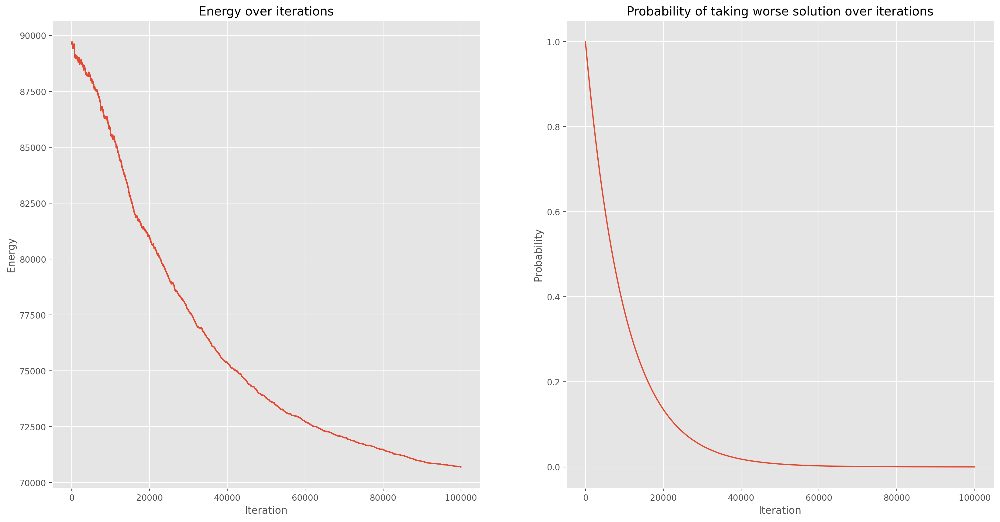

In [39]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset,
                                  consecutive_swap=False, 
                                  temperature_function=Temperature.EXPONENTIAL, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.EIGHT_NEIGHBOURS)
plot_binary_result(dataset, img, fh, ph)

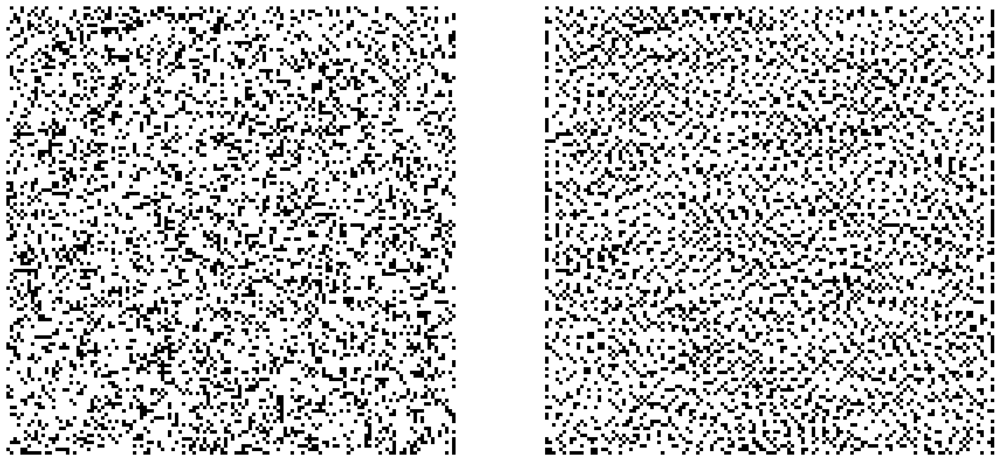

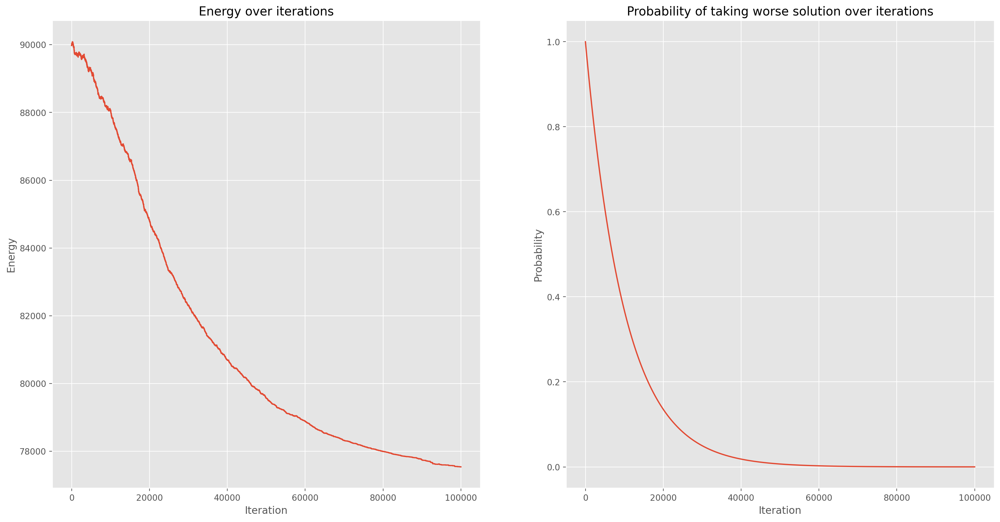

In [40]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=True, 
                                  temperature_function=Temperature.EXPONENTIAL, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.EIGHT_NEIGHBOURS)
plot_binary_result(dataset, img, fh, ph)

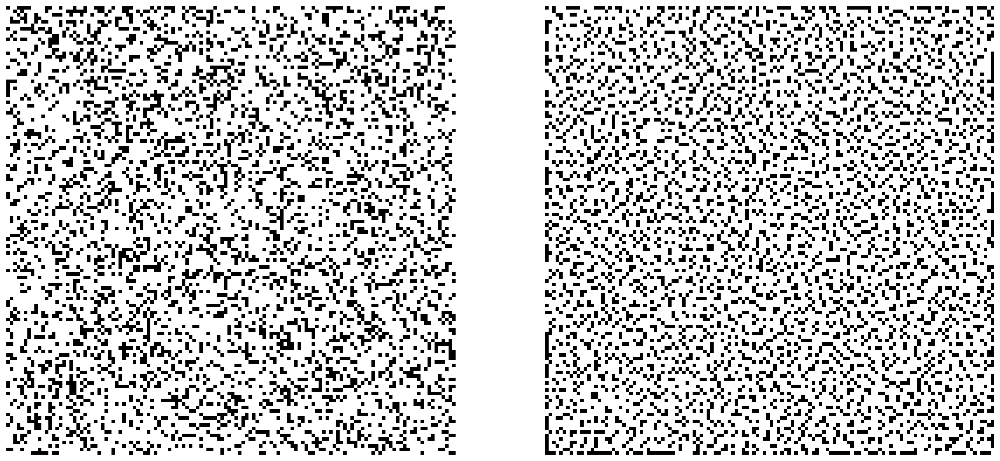

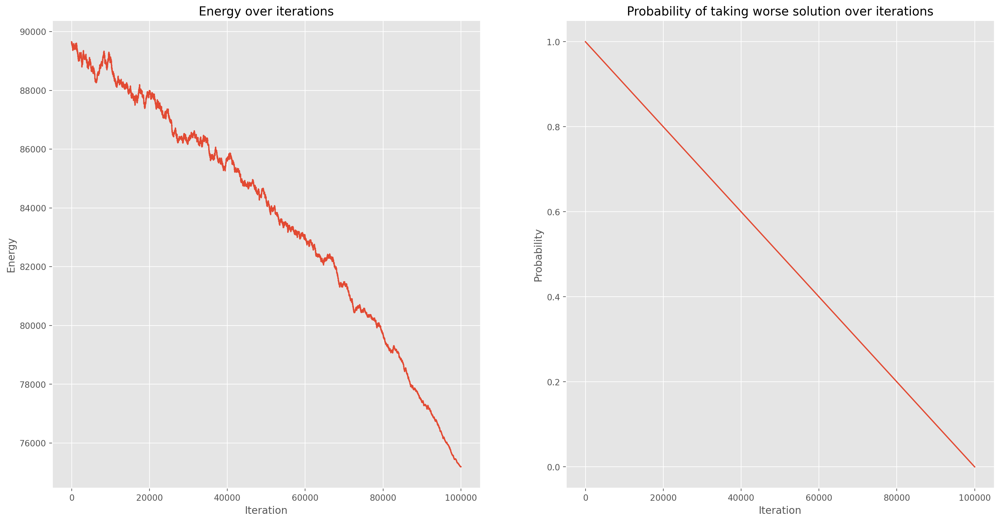

In [41]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=False, 
                                  temperature_function=Temperature.LINEAR, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.EIGHT_NEIGHBOURS)
plot_binary_result(dataset, img, fh, ph)

#### Row neighbours

Czarne punkty utworzyły kolumny punktów.

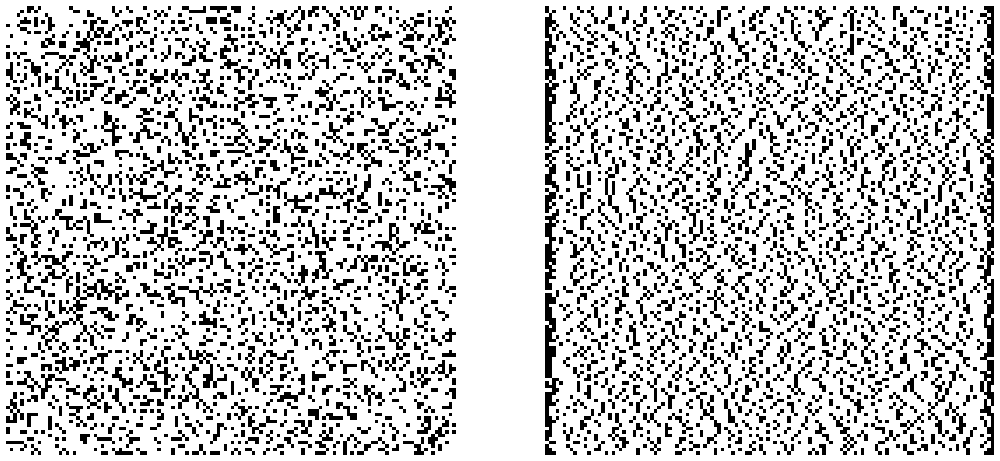

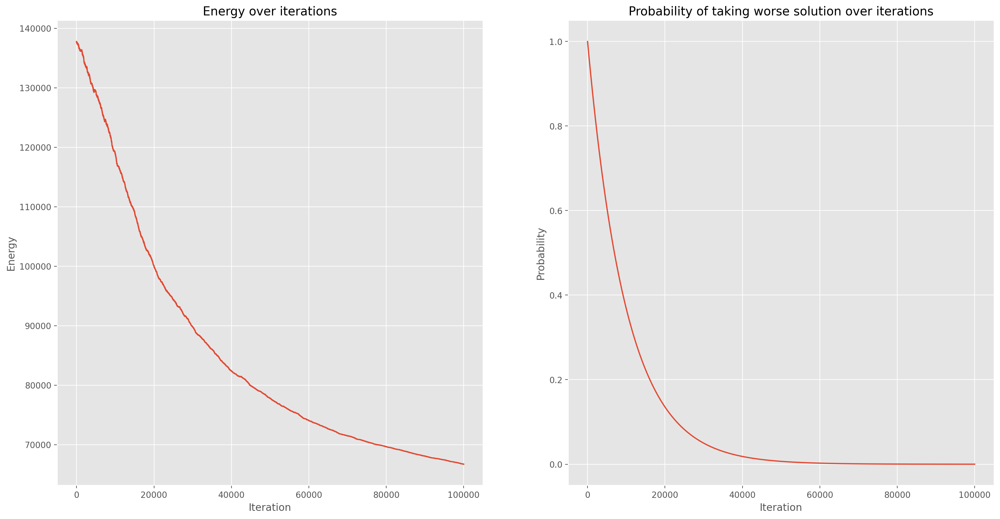

In [42]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=False, 
                                  temperature_function=Temperature.EXPONENTIAL, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.ROW_NEIGHBOURS)
plot_binary_result(dataset, img, fh, ph)

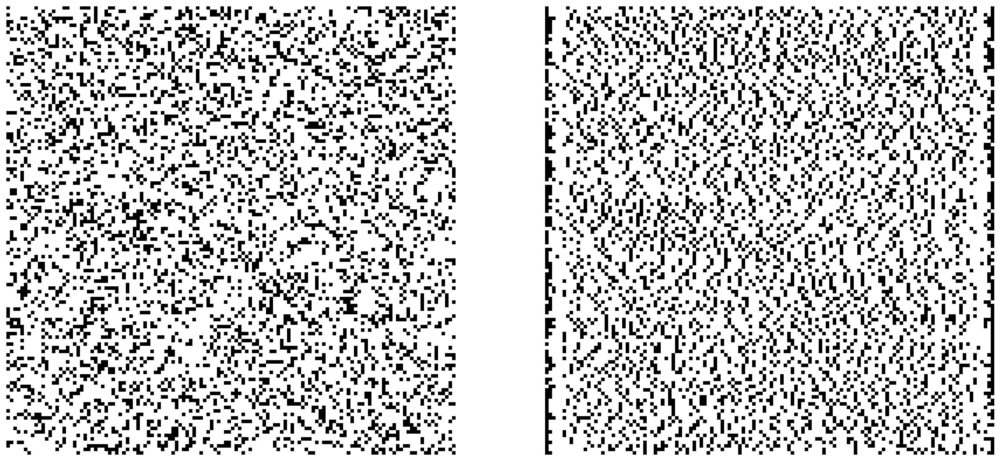

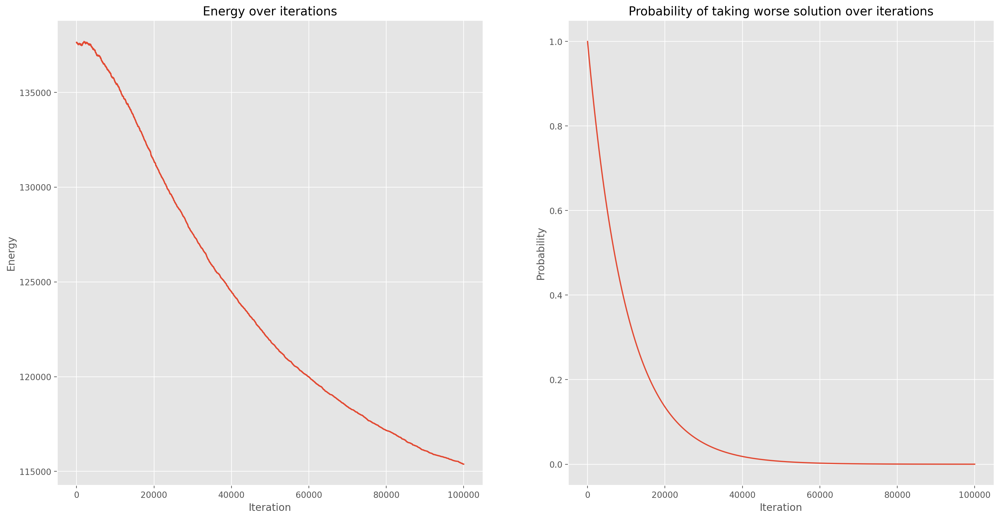

In [43]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=True, 
                                  temperature_function=Temperature.EXPONENTIAL, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.ROW_NEIGHBOURS)
plot_binary_result(dataset, img, fh, ph)

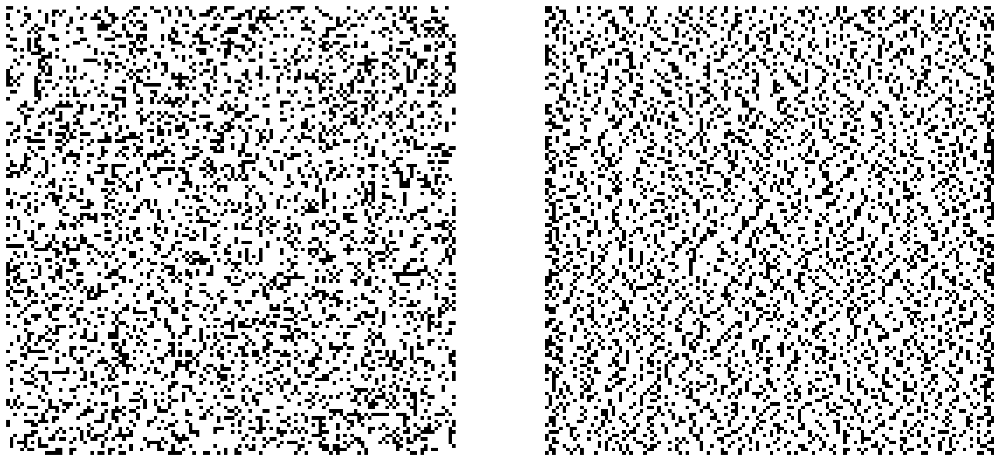

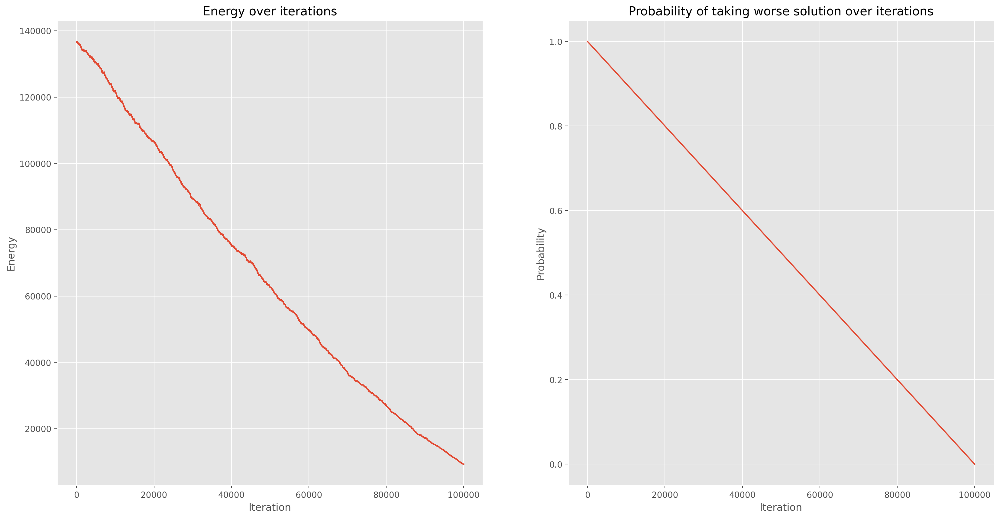

In [44]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=False, 
                                  temperature_function=Temperature.LINEAR, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.ROW_NEIGHBOURS)
plot_binary_result(dataset, img, fh, ph)

#### Column neighbours

Czarne punkty utworzyły rzędy punktów.

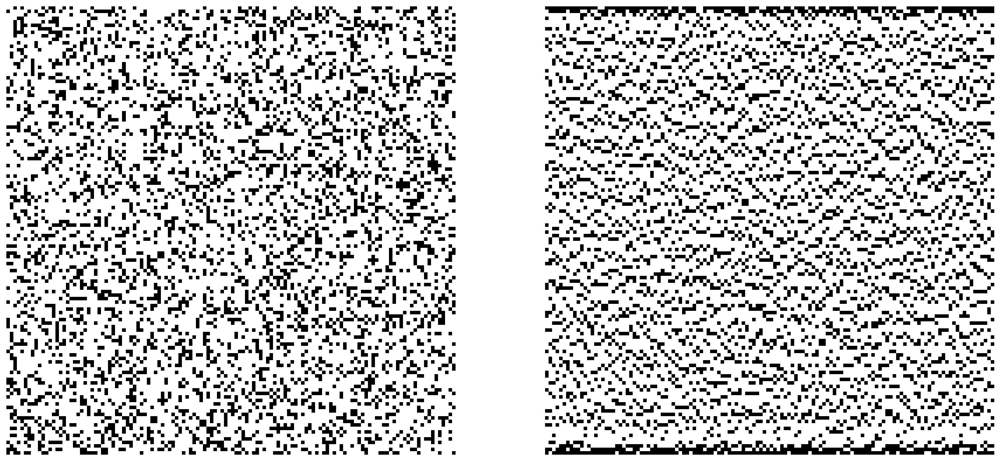

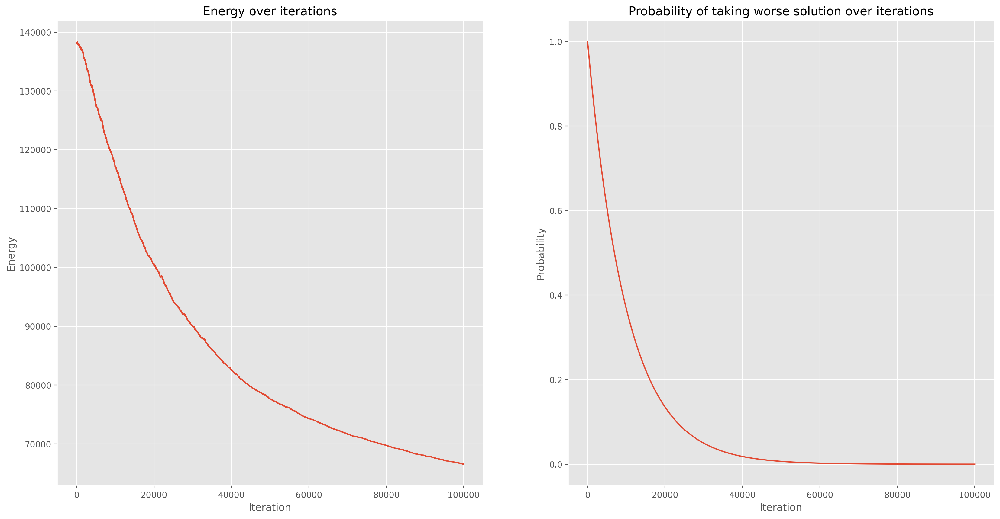

In [45]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=False, 
                                  temperature_function=Temperature.EXPONENTIAL, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.COLUMN_NEIGHBOURS)
plot_binary_result(dataset, img, fh, ph)

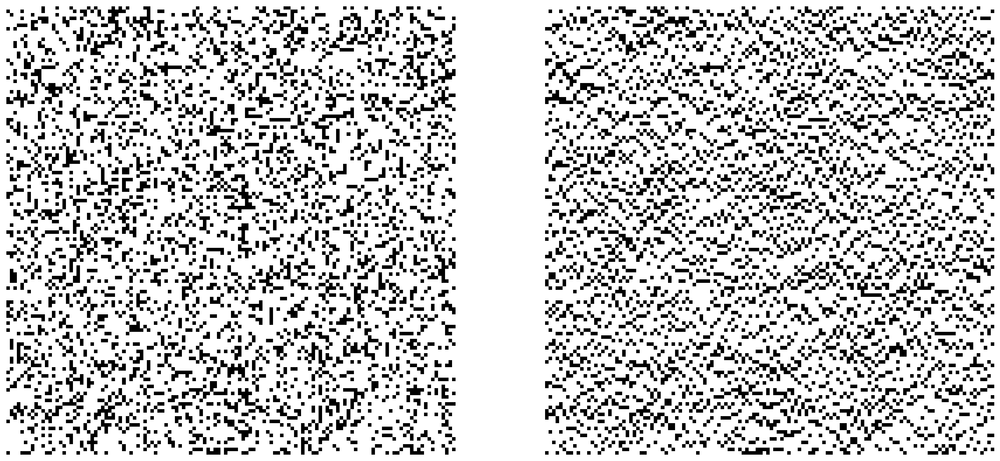

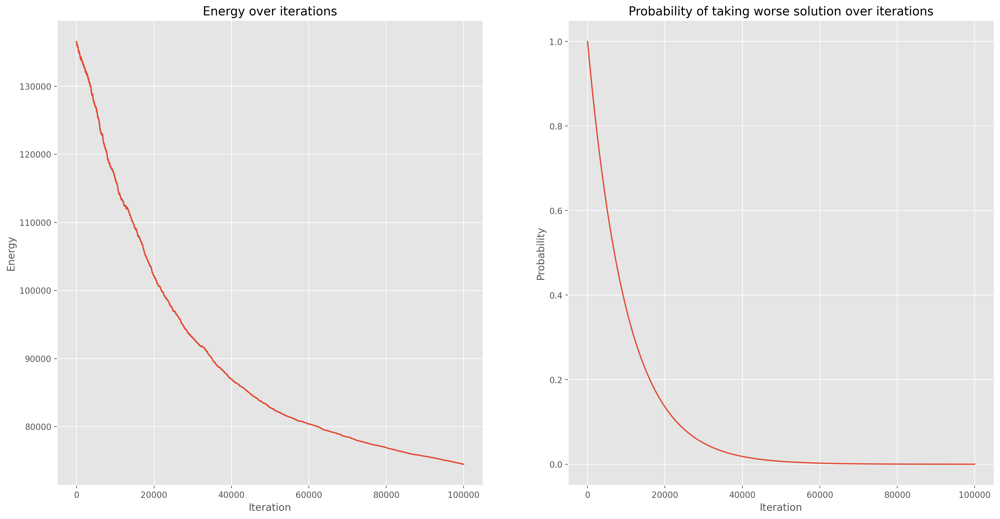

In [46]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=True, 
                                  temperature_function=Temperature.EXPONENTIAL,
                                  iterations = 100000, 
                                  neighbourhood=Energy.COLUMN_NEIGHBOURS)
plot_binary_result(dataset, img, fh, ph)

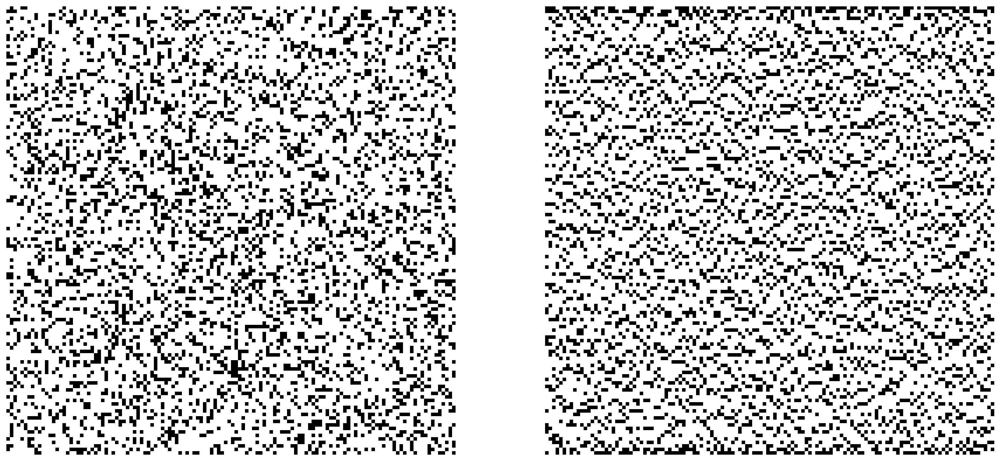

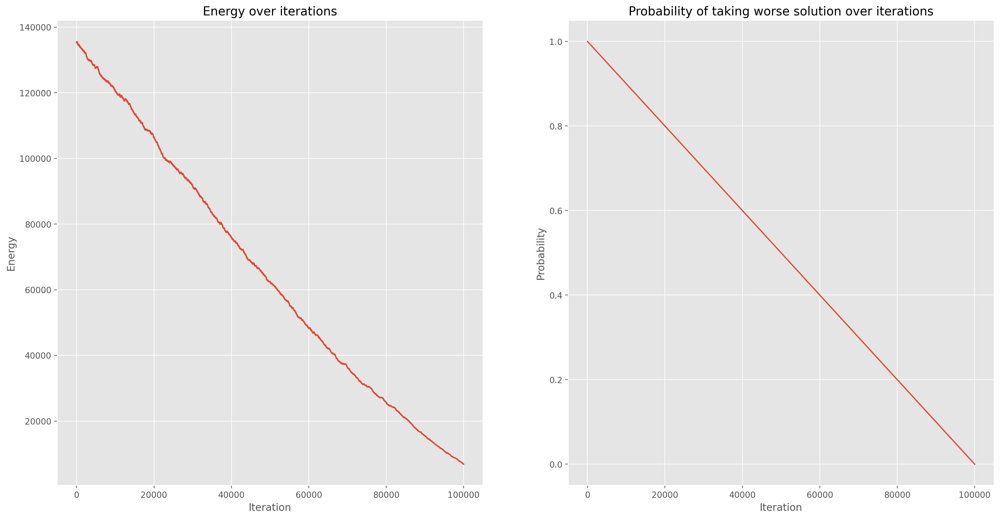

In [47]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=False, 
                                  temperature_function=Temperature.LINEAR, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.COLUMN_NEIGHBOURS)
plot_binary_result(dataset, img, fh, ph)

#### Square 5x5

Czarne punkty utworzyły przekąną z górnego leweggo rogu do dolnego prawego rogu.

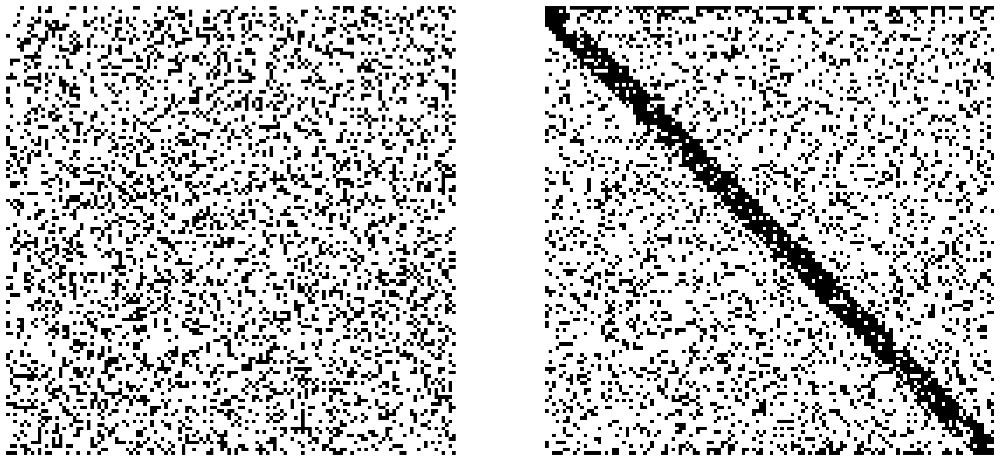

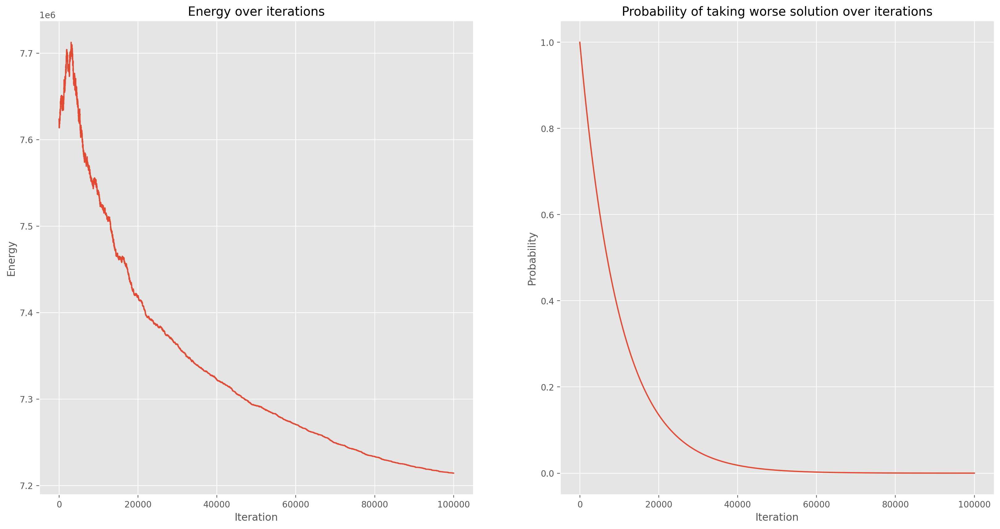

In [8]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=False, 
                                  temperature_function=Temperature.EXPONENTIAL, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.SQUARE_5X5)
plot_binary_result(dataset, img, fh, ph)

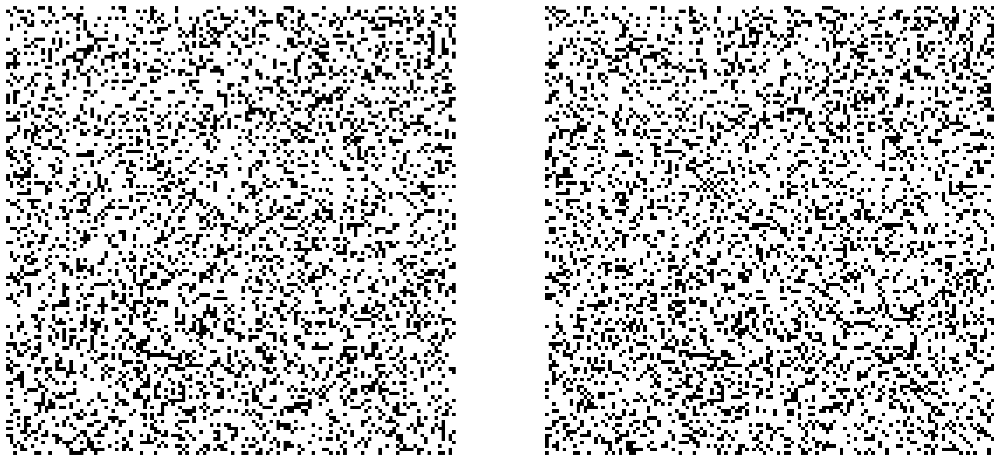

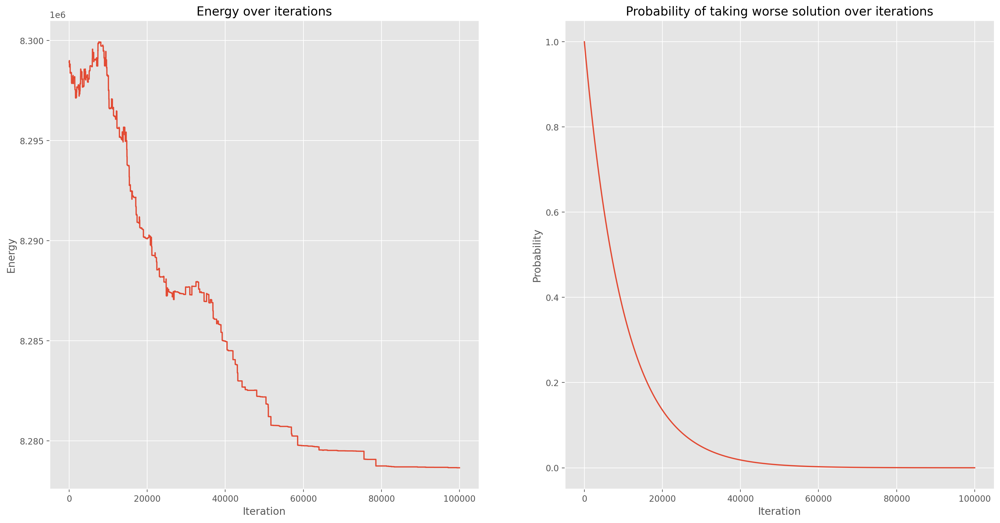

In [5]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=True, 
                                  temperature_function=Temperature.EXPONENTIAL, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.SQUARE_5X5)
plot_binary_result(dataset, img, fh, ph)

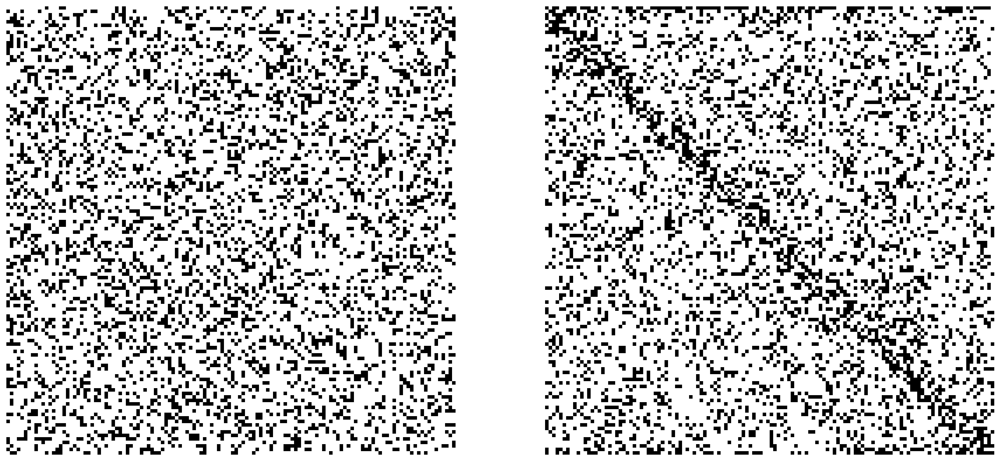

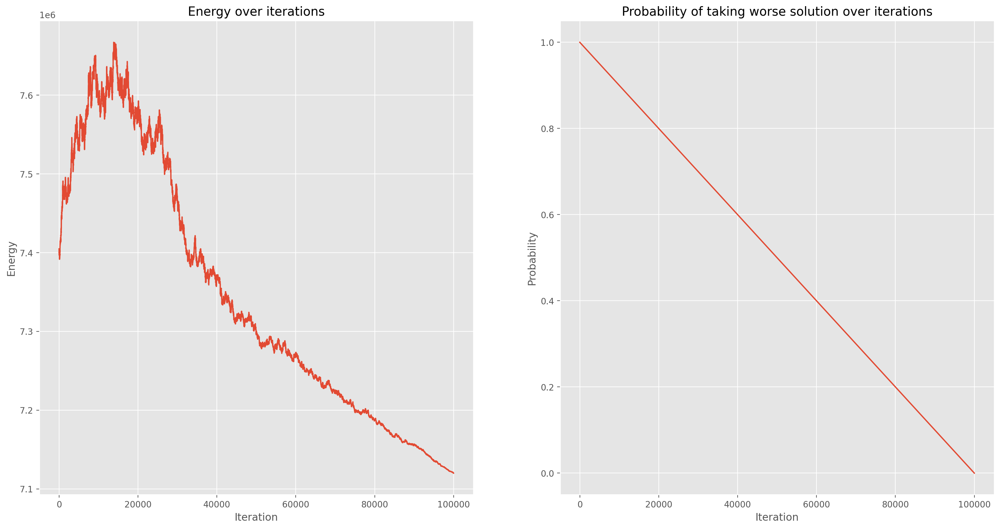

In [6]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=False, 
                                  temperature_function=Temperature.LINEAR, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.SQUARE_5X5)
plot_binary_result(dataset, img, fh, ph)

### Wyniki dla innej funkcji energii

Wykonano dodatkowe obliczenia dla funkcji $E_2(x) = \frac{1}{x^2}$ oraz $E_3(x) = ln(x)$, w celu przetestowania innego zachowania punktów. Wybrano trzy sąsiedztwa: "row neighbours", "eight neighbours" oraz "square 5x5". Wykonano $10^5$ iteracji dla każdego sąsiedztwa i wybrano eksponencjalną funkcję zmiany temperatury. Następne stany były generowane metodą arbitrary swap.

#### Funkcja $E_2(x)$

##### Eight neighbours

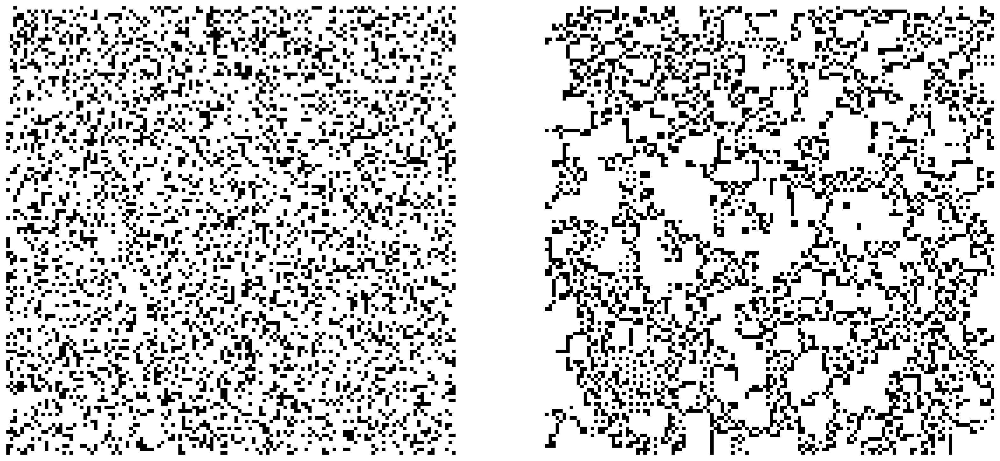

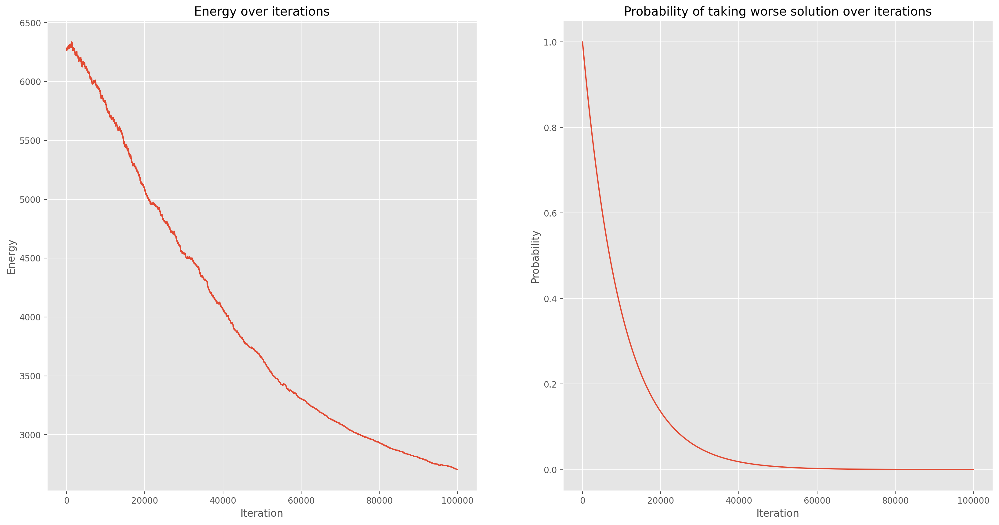

In [51]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=False, 
                                  temperature_function=Temperature.EXPONENTIAL,
                                  iterations = 100000, 
                                  neighbourhood=Energy.EIGHT_NEIGHBOURS, 
                                  func=lambda x: 1/(x*x) if x > 0 else 0)
plot_binary_result(dataset, img, fh, ph)

##### Row neighbours

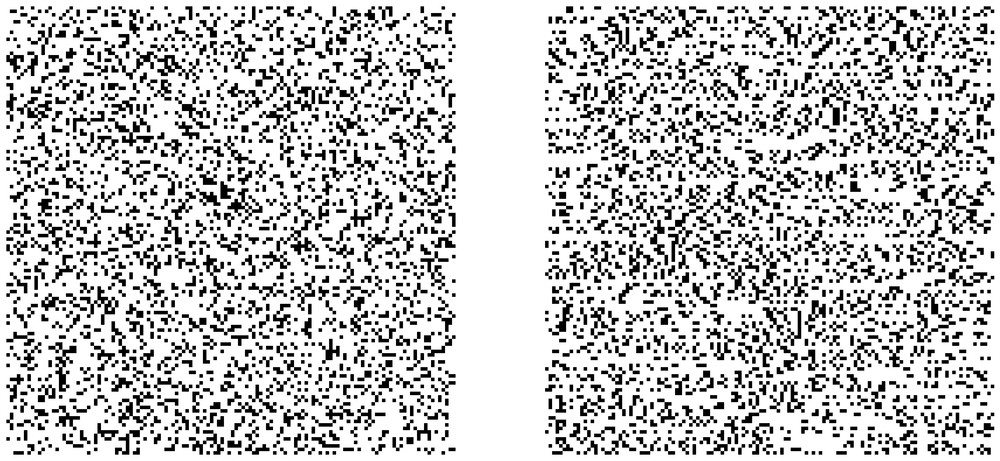

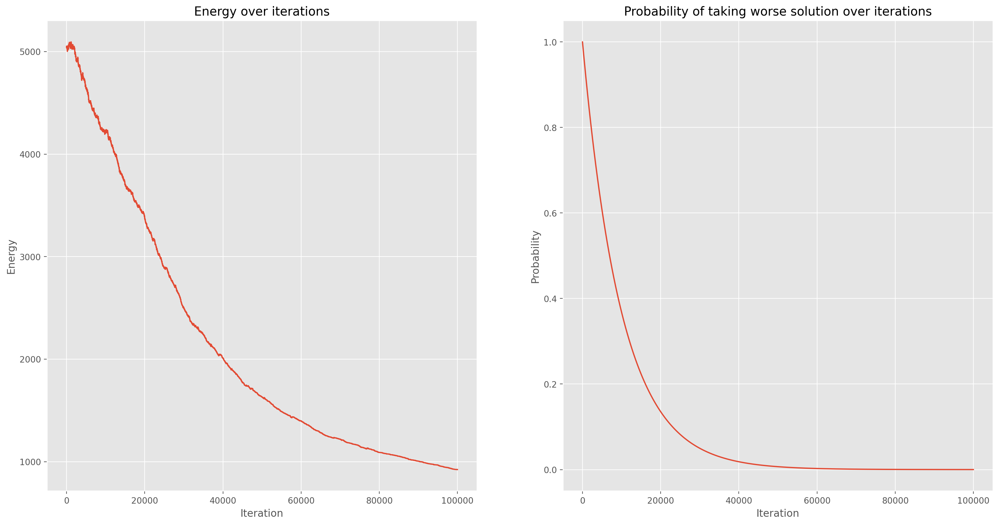

In [11]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=False, 
                                  temperature_function=Temperature.EXPONENTIAL, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.ROW_NEIGHBOURS, 
                                  func=lambda x: 1/(x*x) if x > 0 else 0)
plot_binary_result(dataset, img, fh, ph)

##### Square 5x5

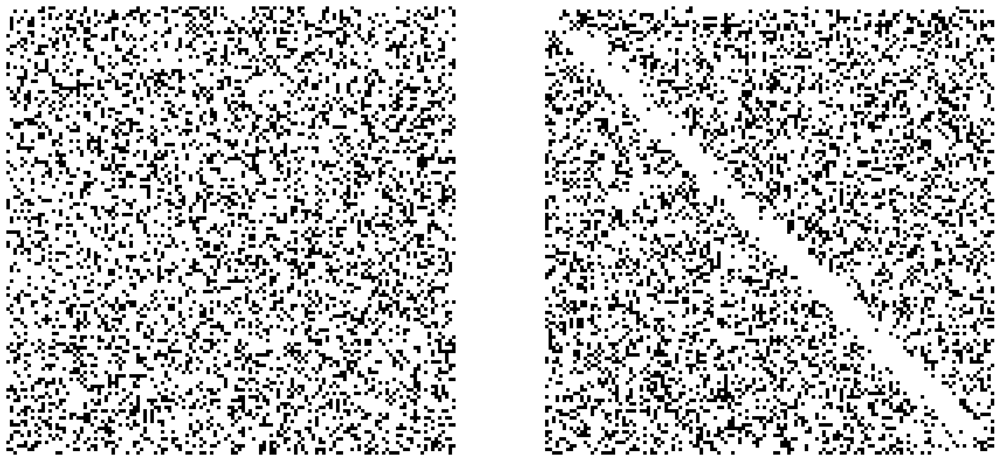

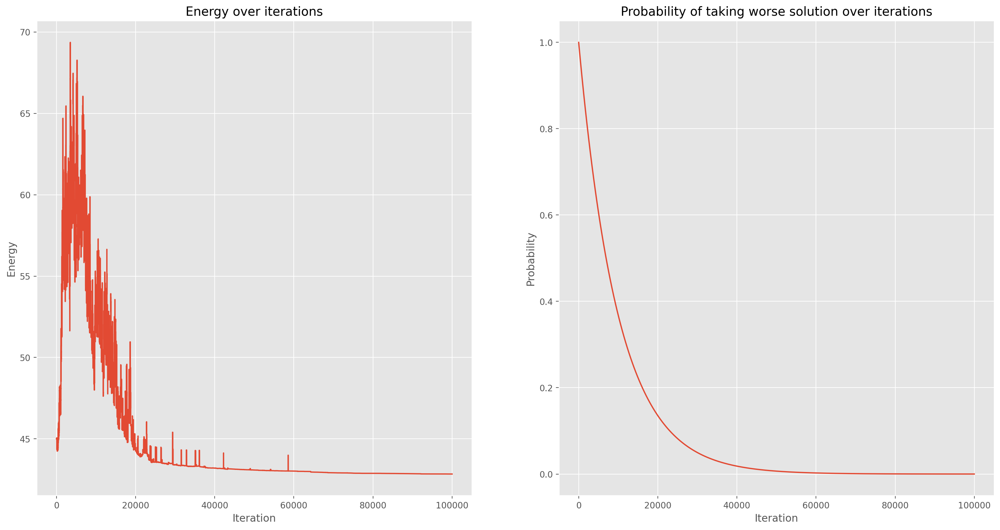

In [10]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=False, 
                                  temperature_function=Temperature.EXPONENTIAL, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.SQUARE_5X5, 
                                  func=lambda x: 1/(x*x) if x > 0 else 0)
plot_binary_result(dataset, img, fh, ph)

#### Funkcja $E_3(x)$

##### Eight neighbours

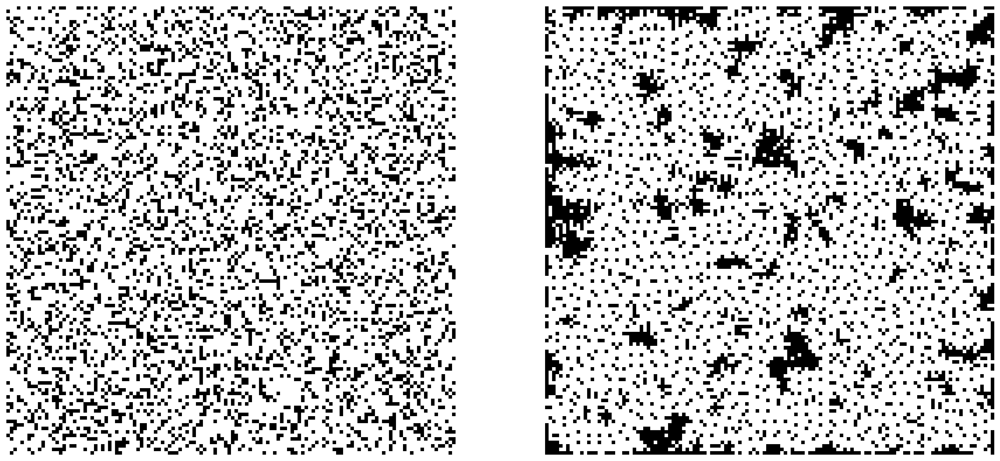

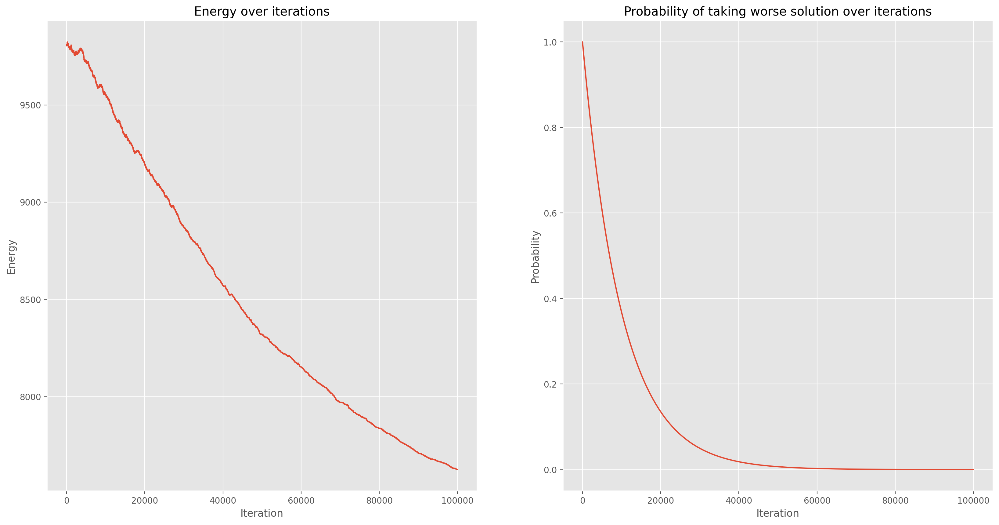

In [9]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=False, 
                                  temperature_function=Temperature.EXPONENTIAL, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.EIGHT_NEIGHBOURS, 
                                  func=lambda x: np.log(x) if x > 0 else 0)
plot_binary_result(dataset, img, fh, ph)

##### Row neighbours

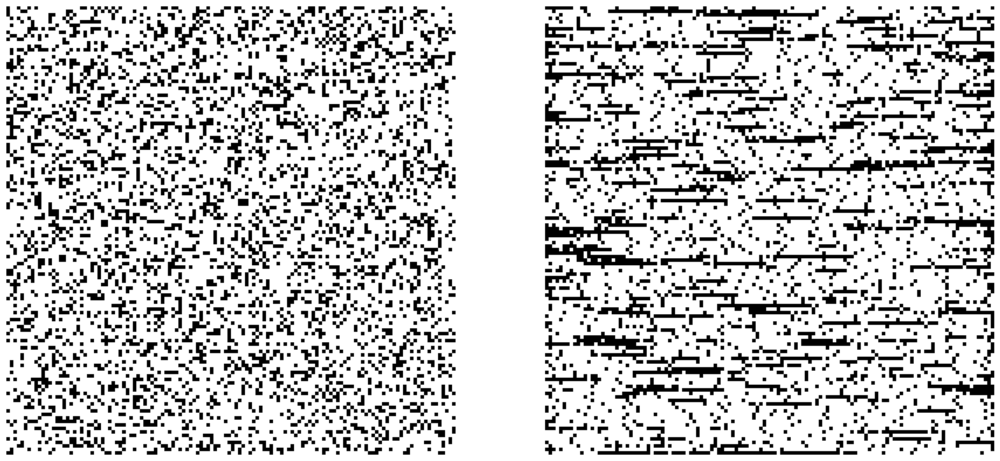

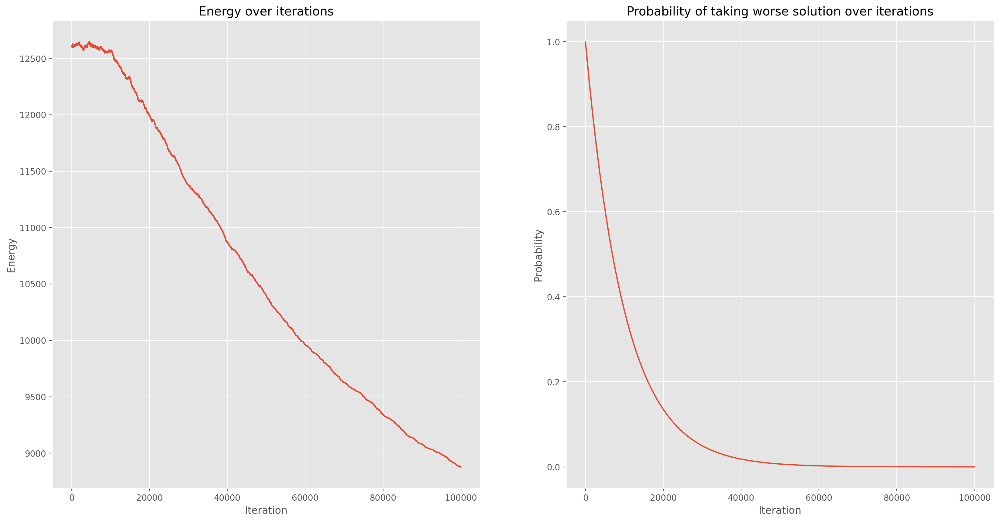

In [12]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=False, 
                                  temperature_function=Temperature.EXPONENTIAL, 
                                  iterations = 100000, 
                                  neighbourhood=Energy.ROW_NEIGHBOURS, 
                                  func=lambda x: np.log(x) if x > 0 else 0)
plot_binary_result(dataset, img, fh, ph)

##### Square 5x5

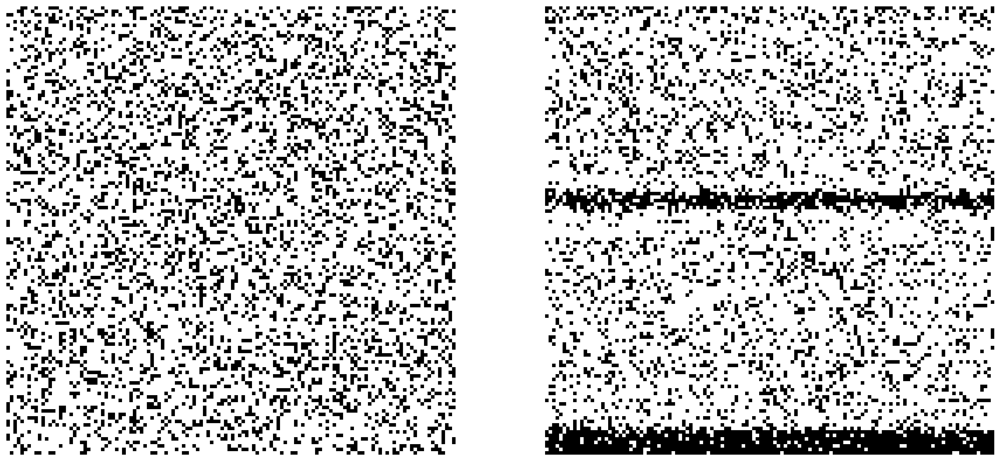

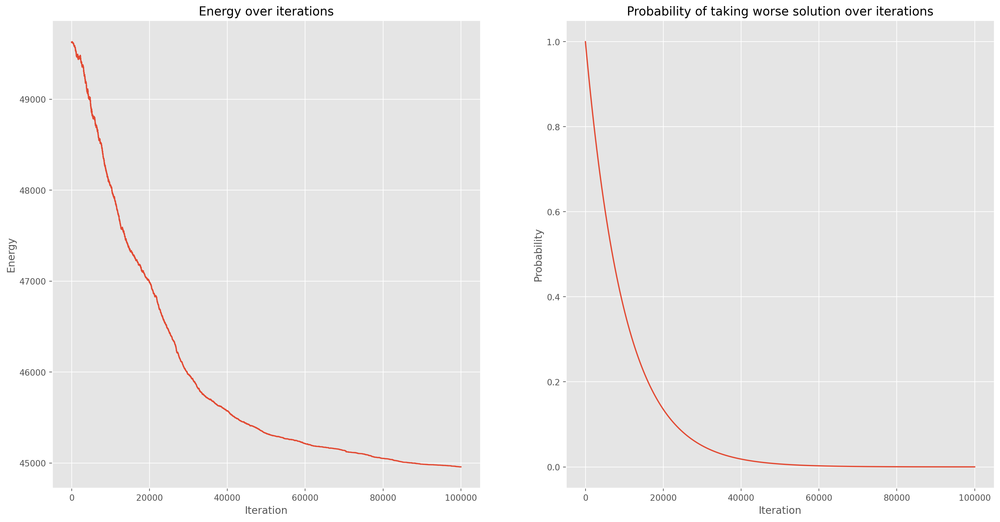

In [13]:
dataset = generate_binary_image(n=128,p=0.25)
img, fh, ph = binary_image_solver(dataset, 
                                  consecutive_swap=False, 
                                  temperature_function=Temperature.EXPONENTIAL,
                                  iterations = 100000, 
                                  neighbourhood=Energy.SQUARE_5X5,
                                  func=lambda x: np.log(x) if x > 0 else 0)
plot_binary_result(dataset, img, fh, ph)

### Wnioski

Dla wszystkich sąsiedztw, najlepsze wyniki uzyskano dla funkcji eksponencjalnej zmiany temperatury z wykorzystaniem metody generacji następnego stanu arbitrary swap. Dla liniowej funkcji zmiany temperatury oraz metody generacji następnego stanu consecutive swap zmiany były zbyt wolne i obrazy zazwyczaj nie zmieniały drastycznie swojej formy. Funkcja liniowa, analogicznie jak dla problemu komiwojażera, przyjmowała na początku więcej gorszych wyników, co mogło spowodować wolniejsze zmiany stanu obrazów. Ciekawym sąsiedztwem był kwadrat $5 \times 5$, który w większości przypadków na początku przyjmował więcej gorszych wyników, niż w przypadku innych sąsiedztw.

Dla funkcji $E_1(x)$ punkty czarne przyciągały się, odpychając przy tym punkty białe, natomiast dla funkcji $E_2(x)$ białe punkty odpychały czarne punkty. Najlepiej widać to dla sąsiedztwa kwadratu $5 \times 5$, gdzie dla funkcji $E_1(x) $ powstała czarna przekątna, a dla funkcji $E_2(x)$ powstała biała przekątna. Natomiast funkcja $E_3(x)$ zachowywała się nietypowo: dla kwadratu $5 \times 5$ zamiast przekątnej wygenerowała dwa czarne paski, dla sąsiedztwa "row neighbours" wygenerowała dużą ilość cienkich pasków, a dla "eight neighbours" wygenerowała grupy czarnych punktów, pomiędzy którymi znajdowały się równoodległe pojedyncze czarne punkty.

## Zadanie 3 - Sudoku

Metoda symulowanego wyżarzania może również zostać wykorzystana do rozwiązywania zagadki sudoku, gdzie funkcja kosztu to suma powtórzeń cyfr w rzędach, kolumnach bloku 9x9 oraz blokach 3x3. W celu generacji stanu sąsiedniego na początu każdy blok 3x3 jest wypełniany niepowtarzającymi się liczbami od 1 do 9 w pustych miejscach. Każdy stan generowany jest w następujący sposób:

1. Wylosowanie odpowiedniego bloku 3x3
2. Zamiana dwóch liczb, które znajdują się na pustych miejscach w początkowym stanie sudoku
3. Obliczenie funkcji kosztu dla nowego stanu

Reszta kroków jest analogiczna do poprzednich zadań.

### Implementacja

In [35]:
class Sudoku:
    def __init__(self, sudoku) -> None:
        self.sudoku_spaces = np.zeros((9, 9), dtype=int)
        self.sudoku = sudoku

        for i in range(9):
            for j in range(9):
                if sudoku[i, j] != 0:
                    self.sudoku_spaces[i, j] = 1

        # Generate list of 3x3 blocks indexes
        self.blocks = [[(i*3 + a, j*3 + b) for a in range(3) for b in range(3)] for i in range(3) for j in range(3)]

        # Randomly fill sudoku
        for block in self.blocks:
            for box in block:
                if self.sudoku[box[0], box[1]] == 0:
                    current_block = self.sudoku[block[0][0]:(block[-1][0]+1), block[0][1]:(block[-1][1]+1)]
                    self.sudoku[box[0], box[1]] = np.random.choice([i for i in range(1, 10) if i not in current_block])


    def calculate_energy(self, array: np.ndarray):
        """Calculate repetition of numbers in array"""
        energy = 0
        for i in range(1, 10):
            array_sum = (array == i).sum()
            energy += array_sum if array_sum > 1 else 0

        return energy

    def calculate_row_energy(self, row, array=None):
        """Calculate repetition of numbers in row"""

        return self.calculate_energy(array[row])
    
    def calculate_column_energy(self, column, array=None):
        """Calculate repetition of numbers in column"""
        return self.calculate_energy(array[:, column])
    
    def calculate_square_energy(self, square, array=None):
        """Calculate repetition of numbers in square"""
        i = square // 3
        j = square % 3
        return self.calculate_energy(array[i*3:(i+1)*3, j*3:(j+1)*3])

    def calculate_whole_energy(self):
        """Calculate repetition of numbers in rows, columns and squares"""

        energy = 0
        for i in range(9):
            energy += self.calculate_row_energy(i, self.sudoku)
            energy += self.calculate_column_energy(i, self.sudoku)
            energy += self.calculate_square_energy(i, self.sudoku)

        return energy

    def random_next_state(self):
        """Generate random next state"""
        next_state = self.sudoku.copy()

        # Get random empty block
        random_block_index = np.random.choice(range(9))
        random_block = self.blocks[random_block_index]

        # Check if there are boxes to swap
        if self.sudoku_spaces[random_block].sum() <= 1:
            return next_state
        
        # Get random empty boxes
        random_boxes = np.random.choice(np.where(self.sudoku_spaces[random_block] == 0)[0], size=2, replace=False)

        # Swap values
        next_state[random_block[random_boxes[0]]], next_state[random_block[random_boxes[1]]] = next_state[random_block[random_boxes[1]]], next_state[random_block[random_boxes[0]]]

        return next_state
        

    def calculate_difference(self, next_state):
        """Calculate difference of energy between current state and next state"""
        difference = 0
        for i in range(9):
            difference += self.calculate_row_energy(i, self.sudoku) - self.calculate_row_energy(i, next_state)
            difference += self.calculate_column_energy(i, self.sudoku) - self.calculate_column_energy(i, next_state)
            difference += self.calculate_square_energy(i, self.sudoku) - self.calculate_square_energy(i, next_state)

        return difference
    
    def update_sudoku(self, next_state):
        """Update sudoku"""
        self.sudoku = next_state

def plot_sudoku_result(cost_history, prob_history):
    fig, ax = plt.subplots(1, 2, figsize=(20, 10))

    ax[0].plot(cost_history)
    ax[0].set_title('Repetitions over iterations')
    ax[0].set_xlabel('Iteration')
    ax[0].set_ylabel('Energy')

    ax[1].plot(prob_history)
    ax[1].set_title('Probability of taking worse solution over iterations')
    ax[1].set_xlabel('Iteration')
    ax[1].set_ylabel('Probability')

    plt.show()

def sudoku_solver(initial_sudoku, temperature_function=Temperature.EXPONENTIAL, iterations = 100000, delta=None):
    # Generate initial route
    sudoku = Sudoku(initial_sudoku)
    best_sudoku = initial_sudoku.copy()

    # Get cost of initial route
    current_fitness = sudoku.calculate_whole_energy()
    best_fitness = current_fitness
    print(f"Initial fitness: {current_fitness}")

    # Run simmulated annealing to optimize cost of path
    T = Temperature(iterations, temperature_function, delta)
    prob_history = []
    fitness_history = []
    for i in range(iterations):
        # Generate next state
        next_state_sudoku = sudoku.random_next_state()

        fit_difference = sudoku.calculate_difference(next_state_sudoku)

        prob_history.append(T.probability)

        if fit_difference > 0 or np.random.uniform(0, 1) < T.probability: 
            sudoku.update_sudoku(next_state_sudoku)
            current_fitness -= fit_difference
            if current_fitness < best_fitness:
                best_sudoku = sudoku.sudoku.copy()
                best_fitness = current_fitness

        T.cool_down()
        fitness_history.append(current_fitness)

    print(f"Best fitness: {best_fitness}")
    print(f"Best sudoku:\n{best_sudoku}")
    return best_sudoku, fitness_history, prob_history 

In [33]:
def read_sudoku_from_file(filename):
    sudoku = np.zeros((9, 9), dtype=int)
    with open(filename, 'r') as f:
        for i, line in enumerate(f.readlines()):
            parsed_line = line.split(',')
            for j in range(9):
                if parsed_line[j] == 'x':
                    sudoku[i, j] = 0
                else:
                    sudoku[i, j] = int(parsed_line[j])

    return sudoku

### Sudoku numer 1

Initial sudoku:
[[3 0 1 0 8 0 5 0 0]
 [0 0 0 0 0 7 0 2 0]
 [9 2 0 0 0 0 8 6 0]
 [0 0 0 1 2 0 0 5 0]
 [0 1 0 0 0 0 3 0 0]
 [6 0 2 7 0 5 0 0 0]
 [4 6 3 2 9 0 0 8 5]
 [2 5 0 8 7 3 0 4 1]
 [0 0 0 0 0 6 0 3 9]]
Initial fitness: 78
Best fitness: 6
Best sudoku:
[[2 4 3 1 6 7 5 9 8]
 [8 9 5 4 3 2 1 7 6]
 [6 7 1 9 8 5 2 4 3]
 [6 8 2 7 5 3 9 1 4]
 [7 1 3 6 9 4 8 5 2]
 [9 5 4 8 2 1 3 6 7]
 [1 2 7 5 4 8 6 3 9]
 [5 9 8 3 7 6 4 2 1]
 [4 3 6 2 1 9 7 8 5]]


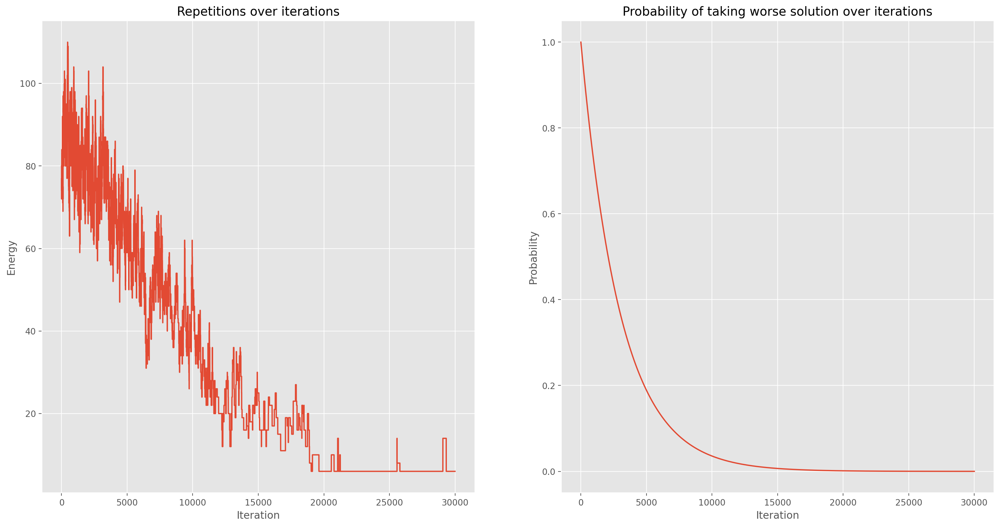

In [50]:
sudoku = read_sudoku_from_file('./sudoku/sudoku1.txt')
print(f"Initial sudoku:\n{sudoku}")
new_sudoku, fh, ph = sudoku_solver(sudoku, temperature_function=Temperature.EXPONENTIAL, iterations = 30000)
plot_sudoku_result(fh, ph)

### Sudoku numer 2

Initial sudoku:
[[0 2 4 0 0 7 0 0 0]
 [6 0 0 0 0 0 0 0 0]
 [0 0 3 6 8 0 4 1 5]
 [4 3 1 0 0 5 0 0 0]
 [5 0 0 0 0 0 0 3 2]
 [7 9 0 0 0 0 0 6 0]
 [2 0 9 7 1 0 8 0 0]
 [0 4 0 0 9 3 0 0 0]
 [3 1 0 0 0 4 7 5 0]]
Initial fitness: 78
Best fitness: 0
Best sudoku:
[[3 4 8 1 9 5 2 6 7]
 [1 7 6 4 3 2 8 5 9]
 [9 5 2 7 8 6 3 4 1]
 [5 2 9 6 1 3 7 8 4]
 [8 6 7 9 2 4 5 1 3]
 [4 1 3 8 5 7 6 9 2]
 [6 8 4 2 7 9 1 3 5]
 [2 3 1 5 4 8 9 7 6]
 [7 9 5 3 6 1 4 2 8]]


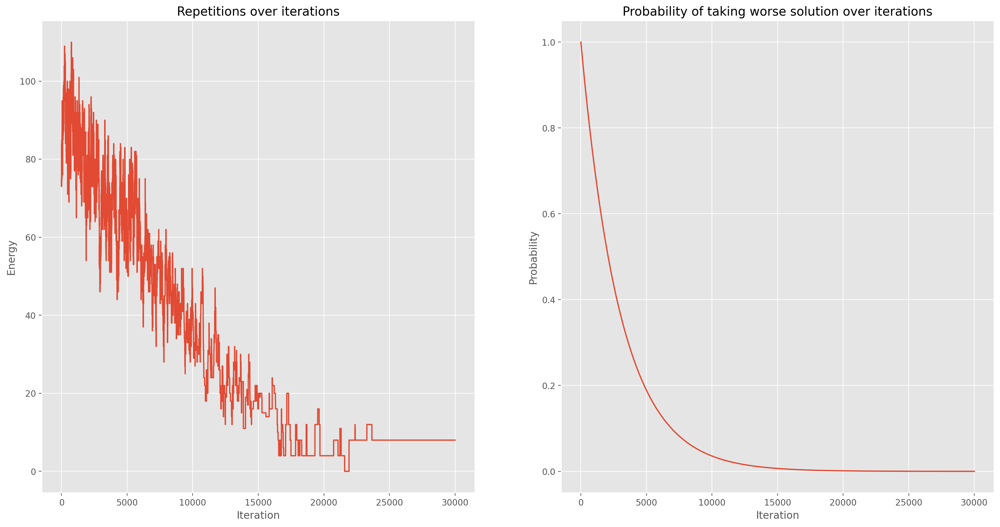

In [49]:
sudoku = read_sudoku_from_file('./sudoku/sudoku2.txt')
print(f"Initial sudoku:\n{sudoku}")
new_sudoku, fh, ph = sudoku_solver(sudoku, temperature_function=Temperature.EXPONENTIAL, iterations = 30000)
plot_sudoku_result(fh, ph)

### Sudoku numer 3

Initial sudoku:
[[0 7 0 3 4 0 2 0 6]
 [9 0 0 7 0 6 0 0 1]
 [0 0 0 0 0 0 0 0 0]
 [2 0 0 0 7 9 8 6 0]
 [0 0 0 0 0 2 3 0 4]
 [4 0 7 5 0 8 0 0 0]
 [0 0 0 9 0 0 0 0 0]
 [0 0 6 0 0 0 0 1 7]
 [5 1 0 0 8 0 4 0 2]]
Initial fitness: 78
Best fitness: 0
Best sudoku:
[[4 8 7 3 2 9 6 5 1]
 [6 1 3 7 8 5 2 9 4]
 [9 5 2 4 6 1 3 8 7]
 [5 6 9 2 4 7 8 1 3]
 [3 4 1 9 5 8 7 2 6]
 [2 7 8 6 1 3 9 4 5]
 [1 9 6 5 7 2 4 3 8]
 [7 2 5 8 3 4 1 6 9]
 [8 3 4 1 9 6 5 7 2]]


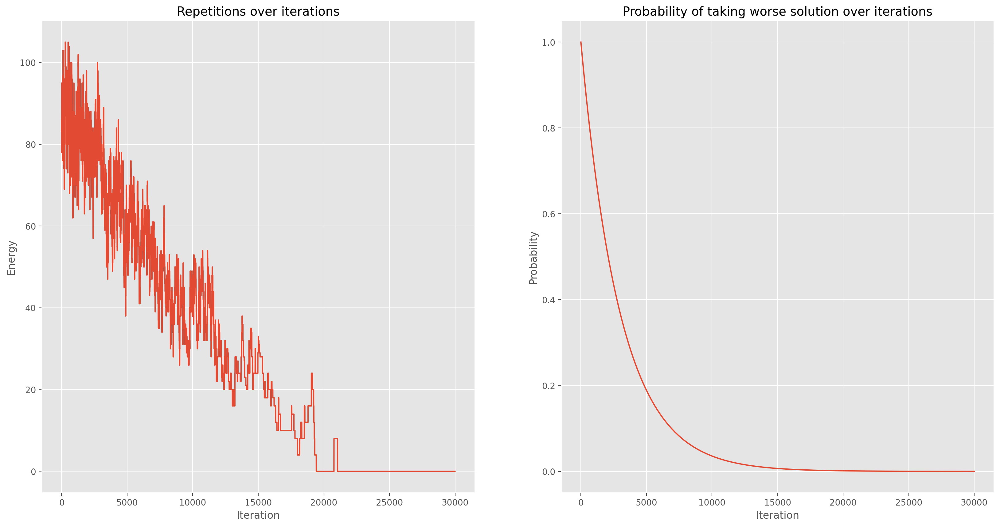

In [48]:
sudoku = read_sudoku_from_file('./sudoku/sudoku3.txt')
print(f"Initial sudoku:\n{sudoku}")
new_sudoku, fh, ph = sudoku_solver(sudoku, temperature_function=Temperature.EXPONENTIAL, iterations = 30000)
plot_sudoku_result(fh, ph)

### Wnioski

Wybrana metoda obliczania następnego stanu, dla sudoku nr 2 oraz 3 pozwoliła na prawidłowe znalezienie rozwiązania. Niestety dla sudoku nr 1 metoda ta nie obliczyła poprawnego rozwiązania. Należałoby wykonać więcej prób dla sudoku nr 1 w celu znalezienia poprawnego rozwiązania (w celu wyjścia z minimum lokalnego funkcji).